In [ ]:
#Library import
import pyarrow as pa
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import statistics
import numpy as np
from datetime import datetime
import requests
from io import StringIO
import matplotlib.ticker as mticker

# **Addition of new variables** - ONI, water level, bunker price and commodity prices - from external sources

## **ONI - Oceanic Niño Index**

In [ ]:
# URL of the webpage containing the PSL file
url = 'https://psl.noaa.gov/data/correlation/oni.data'

# Fetch the content of the webpage
ONI_data = requests.get(url)
ONI_data.raise_for_status()  # Raise an exception for HTTP errors

# Use StringIO to read the PSL content into a pandas DataFrame
ONI = pd.read_csv(StringIO(ONI_data.text), delimiter='\t', header=None)

# Display the first few rows of the DataFrame
display(ONI)

,0
0,1950 2025
1,1950 -1.53 -1.34 -1.16 -1.18 -1.07 -0.8...
2,1951 -0.82 -0.54 -0.17 0.18 0.36 0.5...
3,1952 0.53 0.37 0.34 0.29 0.20 0.0...
4,1953 0.40 0.60 0.63 0.66 0.75 0.7...
...,...
80,From https://www.cpc.ncep.noaa.gov/data/indi...
81,"As of 09/20/2015, uses NOAA ERSST V5 from V3"
82,represents 3 month running mean of ERSST.v5 SST
83,anomalies in the Ni√±o 3.4 region


In [ ]:
# Adjust the table
ONI = ONI[1:76]

# Split data
ONI = ONI[0].str.split('  ', expand=True)
# Replace the header with months
ONI.columns = ['Year', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12']

ONI

,Year,01,02,03,04,05,06,07,08,09,10,11,12
1,1950,-1.53,-1.34,-1.16,-1.18,-1.07,-0.85,-0.54,-0.42,-0.39,-0.44,-0.60,-0.80
2,1951,-0.82,-0.54,-0.17,0.18,0.36,0.58,0.70,0.89,0.99,1.15,1.04,0.81
3,1952,0.53,0.37,0.34,0.29,0.20,0.00,-0.08,0.00,0.15,0.10,0.04,0.15
4,1953,0.40,0.60,0.63,0.66,0.75,0.77,0.75,0.73,0.78,0.84,0.84,0.81
5,1954,0.76,0.47,-0.05,-0.41,-0.54,-0.50,-0.64,-0.84,-0.90,-0.77,-0.73,-0.66
...,...,...,...,...,...,...,...,...,...,...,...,...,...
71,2020,0.50,0.48,0.40,0.19,-0.08,-0.30,-0.41,-0.57,-0.89,-1.17,-1.27,-1.19
72,2021,-1.05,-0.93,-0.84,-0.66,-0.48,-0.38,-0.40,-0.49,-0.67,-0.81,-0.98,-0.98
73,2022,-0.97,-0.93,-0.99,-1.06,-0.99,-0.85,-0.81,-0.91,-1.01,-0.99,-0.92,-0.83
74,2023,-0.68,-0.43,-0.15,0.16,0.48,0.77,1.07,1.32,1.56,1.78,1.92,1.95


In [ ]:
# Adjust the table to keep the relevant years (2018-2024) (Keep 2018 to introduce the lag feature)
ONI_19_24_pivot = ONI[68:]
ONI_19_24_pivot = ONI_19_24_pivot.reset_index(drop=True)
ONI_19_24_pivot

,Year,01,02,03,04,05,06,07,08,09,10,11,12
0,2018,-0.92,-0.85,-0.70,-0.50,-0.22,-0.01,0.09,0.23,0.49,0.76,0.90,0.81
1,2019,0.75,0.72,0.71,0.66,0.54,0.45,0.28,0.14,0.19,0.35,0.51,0.55
2,2020,0.50,0.48,0.40,0.19,-0.08,-0.30,-0.41,-0.57,-0.89,-1.17,-1.27,-1.19
3,2021,-1.05,-0.93,-0.84,-0.66,-0.48,-0.38,-0.40,-0.49,-0.67,-0.81,-0.98,-0.98
4,2022,-0.97,-0.93,-0.99,-1.06,-0.99,-0.85,-0.81,-0.91,-1.01,-0.99,-0.92,-0.83
5,2023,-0.68,-0.43,-0.15,0.16,0.48,0.77,1.07,1.32,1.56,1.78,1.92,1.95
6,2024,1.78,1.48,1.14,0.71,0.39,0.15,0.04,-0.11,-0.21,-0.26,-0.37,-0.53


In [ ]:
# Transpose the rows into a column
# Unpivot/melt the DataFrame
df_melted = ONI_19_24_pivot.melt(id_vars='Year', var_name='Month', value_name='ONI')

# Format 'Month' to two digits and create 'Year_Month'
df_melted['Month'] = df_melted['Month'].astype(str).str.zfill(2)
df_melted['Year_Month'] = df_melted['Year'].astype(str) + '-' + df_melted['Month']

# Create final DataFrame with only 'Year_Month' and 'Value'
ONI_19_24 = df_melted[['Year_Month', 'ONI']].copy()

# Sort the result
ONI_19_24 = ONI_19_24.sort_values('Year_Month').reset_index(drop=True)

# Display the result
display(ONI_19_24)

,Year_Month,ONI
0,2018-01,-0.92
1,2018-02,-0.85
2,2018-03,-0.70
3,2018-04,-0.50
4,2018-05,-0.22
...,...,...
79,2024-08,-0.11
80,2024-09,-0.21
81,2024-10,-0.26
82,2024-11,-0.37


In [ ]:
# Create a lag feature for ONI
for i in range(1, 5):  # Loop through lag values 1 to 4
    ONI_19_24[f'ONI_lag_{i}'] = ONI_19_24['ONI'].shift(i)
ONI_19_24

,Year_Month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,ONI_lag_4
0,2018-01,-0.92,None,None,None,None
1,2018-02,-0.85,-0.92,None,None,None
2,2018-03,-0.70,-0.85,-0.92,None,None
3,2018-04,-0.50,-0.70,-0.85,-0.92,None
4,2018-05,-0.22,-0.50,-0.70,-0.85,-0.92
...,...,...,...,...,...,...
79,2024-08,-0.11,0.04,0.15,0.39,0.71
80,2024-09,-0.21,-0.11,0.04,0.15,0.39
81,2024-10,-0.26,-0.21,-0.11,0.04,0.15
82,2024-11,-0.37,-0.26,-0.21,-0.11,0.04


In [ ]:
# Remove 2018 year (Remove the first 12 rows)
ONI_19_24 = ONI_19_24.iloc[12:]
ONI_19_24

,Year_Month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,ONI_lag_4
12,2019-01,0.75,0.81,0.90,0.76,0.49
13,2019-02,0.72,0.75,0.81,0.90,0.76
14,2019-03,0.71,0.72,0.75,0.81,0.90
15,2019-04,0.66,0.71,0.72,0.75,0.81
16,2019-05,0.54,0.66,0.71,0.72,0.75
...,...,...,...,...,...,...
79,2024-08,-0.11,0.04,0.15,0.39,0.71
80,2024-09,-0.21,-0.11,0.04,0.15,0.39
81,2024-10,-0.26,-0.21,-0.11,0.04,0.15
82,2024-11,-0.37,-0.26,-0.21,-0.11,0.04


In [ ]:
# Download ONI_19_24 to parquet
#ONI_19_24.to_parquet('ONI_19_24.parquet')

### **Import Bulk_PA dataframe and merge ONI**

In [ ]:
# Import the Bulk dataframe from parquet
Bulk_PA = pd.read_parquet('Bulk_PA_Clean.parquet')
#Bulk_PA = pd.read_parquet('Bulk_PA_original_data_no_duplicates.parquet')
# Display all the columns
pd.set_option('display.max_columns', None)

In [ ]:
# Create a new column to estimate the transit month and convert to period M
Bulk_PA['proxy_transit_month'] = Bulk_PA['load_end_date'].dt.to_period('M')
# Convert ONI Year_Month dates to period M
if ONI_19_24['Year_Month'].dtype != 'period[M]':
  ONI_19_24['Year_Month'] = pd.to_datetime(ONI_19_24['Year_Month'].str.strip(), format='%Y-%m', errors='coerce')
  ONI_19_24['Year_Month'] = ONI_19_24['Year_Month'].dt.to_period('M')

<ipython-input-10-0ce16a748ee9>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ONI_19_24['Year_Month'] = pd.to_datetime(ONI_19_24['Year_Month'].str.strip(), format='%Y-%m', errors='coerce')
<ipython-input-10-0ce16a748ee9>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ONI_19_24['Year_Month'] = ONI_19_24['Year_Month'].dt.to_period('M')


In [ ]:
# Add a new column for the ONI variable
Bulk_PA['ONI'] = np.nan

In [ ]:
# Add ONI information to Bulk_PA
for index, row in Bulk_PA.iterrows():
    year_month = row['proxy_transit_month']
    matching_row = ONI_19_24[ONI_19_24['Year_Month'] == year_month]

    if not matching_row.empty:
        # Convert 'ONI' value to numeric before assigning
        try:
            ONI_value = pd.to_numeric(matching_row['ONI'].values[0])
            Bulk_PA.loc[index, 'ONI'] = ONI_value

            ONI_lag_1_value = pd.to_numeric(matching_row['ONI_lag_1'].values[0])
            Bulk_PA.loc[index, 'ONI_lag_1'] = ONI_lag_1_value

            ONI_lag_2_value = pd.to_numeric(matching_row['ONI_lag_2'].values[0])
            Bulk_PA.loc[index, 'ONI_lag_2'] = ONI_lag_2_value

            ONI_lag_3_value = pd.to_numeric(matching_row['ONI_lag_3'].values[0])
            Bulk_PA.loc[index, 'ONI_lag_3'] = ONI_lag_3_value
        except ValueError:
            print(f"Warning: Could not convert ONI value '{matching_row['ONI'].values[0]}' to numeric. Skipping.")

Bulk_PA

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,3.771151e+08,2.038345e+07,3.040235e+06,42224.579360,400.538755,4356.492000,37868.087360,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,5.530144e+08,4.796344e+07,1.508180e+07,111108.555800,616.059661,7549.750000,103558.805800,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,4.471519e+08,2.757838e+07,6.145678e+06,53915.680010,480.875986,6947.151000,46968.529010,6947.151000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76
4,USG,USA,Port Arthur,11.90,2019-01-01 10:59:37,2019-01-04,Far East,Japan,Yokkaichi,6.0,2019-02-20,2019-02-25 03:19:47,Petroleum Coke,Bulk,9407873,55277,XIN AN YUAN,Bulk Carrier,14.6,12.520,0,5.90,95.0479,48968,11.84,81.10,17.18,1312.333333,860.150000,Yokkaichi,0.000000,NaN,NaN,NaN,NaN,NaN,10184.176000,NaN,10184.176000,1,0,0,0,0,0,0,0,0,0,0,1,0,0,NE_America_to_E_Asia,E_Asia-NE_America,10309.0,33.040,16008.0,51.310,5699.0,18.270,55.281793,Cape of Good Hope,2019-01,0.75,0.81,0.90,0.76
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

## **Water Level data** - Panama Canal Gatun Lake water level

Source: Panama Canal Authority (n.d.) https://evtms-rpts.pancanal.com/eng/h2o/index.html

In [ ]:
# Import and read the water level statistics from a csv file
WL_historic = pd.read_csv('Download_Gatun_Lake_Water_Level_History.csv')
WL_historic

,DATE_LOG,GATUN_LAKE_LEVEL(FEET)
0,1965-01-01,86.49
1,1965-01-02,86.48
2,1965-01-03,86.47
3,1965-01-04,86.46
4,1965-01-05,86.42
...,...,...
21946,2025-02-01,88.11
21947,2025-02-02,88.06
21948,2025-02-03,88.02
21949,2025-02-04,87.98


In [ ]:
# Convert to meters (as other variables are expreced in meters)
WL_historic['GATUN_LAKE_LEVEL(FEET)'] = WL_historic['GATUN_LAKE_LEVEL(FEET)'] * 0.3048

In [ ]:
# Rename the columns for clarity
WL_historic = WL_historic.rename(columns={'GATUN_LAKE_LEVEL(FEET)': 'water_level_m'})
WL_historic = WL_historic.rename(columns={'DATE_LOG': 'Year_Month'})
# Convert to date time
WL_historic['Year_Month'] = pd.to_datetime(WL_historic['Year_Month'], format='%Y-%m-%d', errors='coerce')
WL_historic['water_level_m'] = WL_historic['water_level_m'].replace(0, np.nan)
WL_historic

,Year_Month,water_level_m
0,1965-01-01,26.362152
1,1965-01-02,26.359104
2,1965-01-03,26.356056
3,1965-01-04,26.353008
4,1965-01-05,26.340816
...,...,...
21946,2025-02-01,26.855928
21947,2025-02-02,26.840688
21948,2025-02-03,26.828496
21949,2025-02-04,26.816304


In [ ]:
# Create a new df with monthly mean only
WL_historic_mean = pd.DataFrame()
WL_historic_mean = WL_historic.groupby(WL_historic['Year_Month'].dt.to_period('M'))['water_level_m'].mean()
WL_historic_mean = WL_historic_mean.reset_index()

WL_historic_mean

,Year_Month,water_level_m
0,1965-01,26.323610
1,1965-02,26.137689
2,1965-03,25.762286
3,1965-04,25.414427
4,1965-05,25.200176
...,...,...
717,2024-10,26.456542
718,2024-11,26.731570
719,2024-12,27.022388
720,2025-01,26.994563


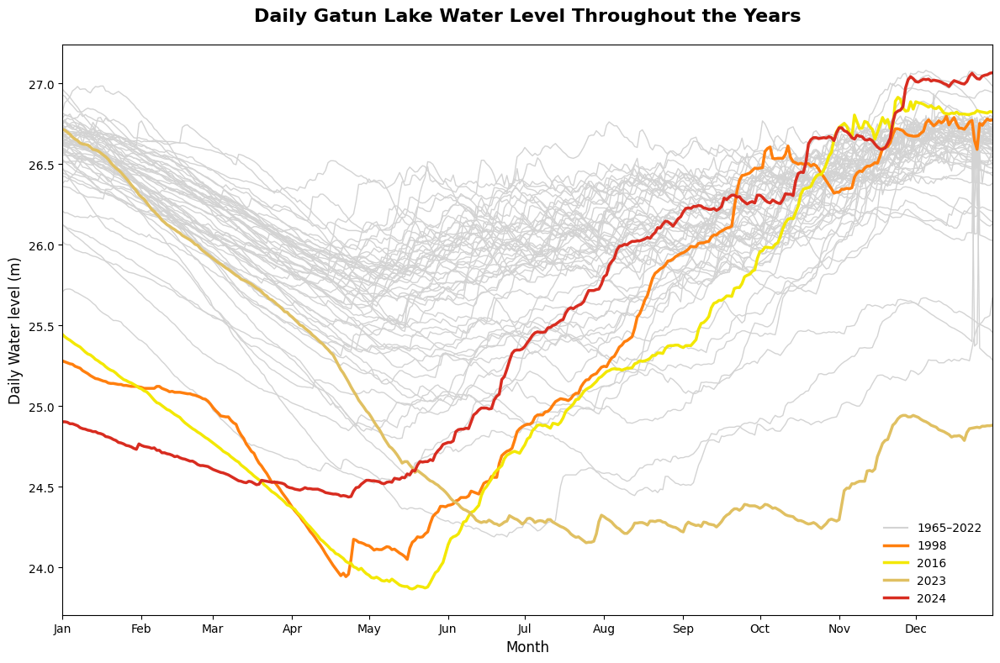

In [ ]:
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
from matplotlib.lines import Line2D

# Create a Graph of Monthly water level change per year for the whole dataset

# Copy the WL data frame for manipulation
WL_Graph = WL_historic.copy()

# Ensure datetime for Year Month
WL_Graph['Year_Month'] = pd.to_datetime(WL_Graph['Year_Month'])

# Extract the years
WL_Graph['Year'] = WL_Graph['Year_Month'].dt.year

# create a dummy date for the x-axis by combining the year 1900 with the month and day
# This avoids issues with invalid day/month combinations in the target year (1900)
WL_Graph['Month_Day'] = pd.to_datetime(WL_Graph['Year_Month'].dt.month.astype(str) + '-' + WL_Graph['Year_Month'].dt.day.astype(str) + '-1900', format='%m-%d-%Y', errors='coerce')


# pivot to wide form: index is Month_Day, columns are years
WL_Graph_pivot = WL_Graph.pivot(index='Month_Day', columns='Year', values='water_level_m')

# Create the Graph
fig, ax = plt.subplots(figsize=(12,8))

# Background lines (1965–2022)
hist_years = [y for y in WL_Graph_pivot.columns if 1965 <= y <= 2022]
for y in hist_years:
    ax.plot(WL_Graph_pivot.index, WL_Graph_pivot[y],
            color='lightgrey', linewidth=1)

# Highlight key drought years
highlights = {
    1998: {'color':'#FF7F0E','linewidth':2.5, 'label':'1998'},
    2016: {'color':'#F3E803','linewidth':2.5, 'label':'2016'},
    2023: {'color':'#e0c062','linewidth':2.5, 'label':'2023'},
}
for year, style in highlights.items():
    if year in WL_Graph_pivot.columns:
        ax.plot(WL_Graph_pivot.index, WL_Graph_pivot[year],
                color=style['color'],
                linewidth=style['linewidth'],
                label=str(year))

# Adjust the 2024 year
if 2024 in WL_Graph_pivot.columns:
    ax.plot(WL_Graph_pivot.index, WL_Graph_pivot[2024],
            color='#d82c20', linewidth=2.5,
            label='2024 (so far)')

# X-axis: month labels
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(DateFormatter('%b'))
ax.set_xlim(pd.to_datetime('1900-01-01'), pd.to_datetime('1900-12-31'))

# X-axis label
ax.set_xlabel('Month', fontsize=12)

# Y-axis: meters
ax.set_ylabel('Daily Water level (m)', fontsize=12)

# Title & annotations
ax.set_title("Daily Gatun Lake Water Level Throughout the Years",
             fontsize=16, fontweight='bold', pad=20)

# Legend
legend_handles = [
    Line2D([0], [0], color='lightgrey', lw=1.5, label='1965–2022'),
    Line2D([0], [0], color='#FF7F0E', lw=2.5,   label='1998'),
    Line2D([0], [0], color='#F3E803', lw=2.5,   label='2016'),
    Line2D([0], [0], color='#e0c062', lw=2.5, label='2023'),
    Line2D([0], [0], color='#d82c20', lw=2.5, label='2024'),
]
ax.legend(handles=legend_handles, loc='lower right', frameon=False)

plt.tight_layout()
plt.show()

In [ ]:
# Create a lag feature for water level
for i in range(1, 5):  # Loop through lag values 1 to 4
    WL_historic_mean[f'water_level_m_lag_{i}'] = WL_historic_mean['water_level_m'].shift(i)

In [ ]:
# Keep relevant years (2019 - 2024)
WL_19_24 = WL_historic_mean[(WL_historic_mean['Year_Month'] >= '2019-01') & (WL_historic_mean['Year_Month'] < '2025-01')]
# Reset index
WL_19_24 = WL_19_24.reset_index(drop=True)
WL_19_24

,Year_Month,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,water_level_m_lag_4
0,2019-01,26.188514,26.786906,26.810513,26.664789,26.320699
1,2019-02,25.857926,26.188514,26.786906,26.810513,26.664789
2,2019-03,25.290731,25.857926,26.188514,26.786906,26.810513
3,2019-04,24.721515,25.290731,25.857926,26.188514,26.786906
4,2019-05,24.407302,24.721515,25.290731,25.857926,26.188514
...,...,...,...,...,...,...
67,2024-08,26.031493,25.561315,25.030379,24.602571,24.476050
68,2024-09,26.252932,26.031493,25.561315,25.030379,24.602571
69,2024-10,26.456542,26.252932,26.031493,25.561315,25.030379
70,2024-11,26.731570,26.456542,26.252932,26.031493,25.561315


In [ ]:
# Add water level information to Bulk_PA
for index, row in Bulk_PA.iterrows():
    year_month = row['proxy_transit_month']
    matching_row = WL_19_24[WL_19_24['Year_Month'] == year_month]

    if not matching_row.empty:
        # Convert 'WL' value to numeric before assigning
        try:
            WL_value = pd.to_numeric(matching_row['water_level_m'].values[0])
            Bulk_PA.loc[index, 'water_level_m'] = WL_value

            WL_lag_1_value = pd.to_numeric(matching_row['water_level_m_lag_1'].values[0])
            Bulk_PA.loc[index, 'water_level_m_lag_1'] = WL_lag_1_value

            WL_lag_2_value = pd.to_numeric(matching_row['water_level_m_lag_2'].values[0])
            Bulk_PA.loc[index, 'water_level_m_lag_2'] = WL_lag_2_value

            WL_lag_3_value = pd.to_numeric(matching_row['water_level_m_lag_3'].values[0])
            Bulk_PA.loc[index, 'water_level_m_lag_3'] = WL_lag_3_value

        except ValueError:
            print(f"Warning: Could not convert WL value '{matching_row['water_level_m'].values[0]}' to numeric. Skipping.")

Bulk_PA

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,3.771151e+08,2.038345e+07,3.040235e+06,42224.579360,400.538755,4356.492000,37868.087360,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,5.530144e+08,4.796344e+07,1.508180e+07,111108.555800,616.059661,7549.750000,103558.805800,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,4.471519e+08,2.757838e+07,6.145678e+06,53915.680010,480.875986,6947.151000,46968.529010,6947.151000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789
4,USG,USA,Port Arthur,11.90,2019-01-01 10:59:37,2019-01-04,Far East,Japan,Yokkaichi,6.0,2019-02-20,2019-02-25 03:19:47,Petroleum Coke,Bulk,9407873,55277,XIN AN YUAN,Bulk Carrier,14.6,12.520,0,5.90,95.0479,48968,11.84,81.10,17.18,1312.333333,860.150000,Yokkaichi,0.000000,NaN,NaN,NaN,NaN,NaN,10184.176000,NaN,10184.176000,1,0,0,0,0,0,0,0,0,0,0,1,0,0,NE_America_to_E_Asia,E_Asia-NE_America,10309.0,33.040,16008.0,51.310,5699.0,18.270,55.281793,Cape of Good Hope,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906

## **Bunker Price data** - IFO380

Data source: United States Department of Agriculture (2025) https://agtransport.usda.gov/Fuel/Daily-Bunker-Fuel-Prices/4v3x-mj86/about_data

In [ ]:
# Read Daily bunker fuel prices from excel
Daily_Bunker = pd.read_csv('Daily_Bunker_Fuel_Prices_20250402.csv')
Daily_Bunker

,Day,Month,Year,"VLSFO Fuel Oil, IMO 2020 Grade, 0.5%",Marine Gas Oil,"Intermdiate Fuel Oil, 180cSt","Intermdiate Fuel Oil, 380cSt"
0,01/29/2019,January,2019,414.75,636.5,429.0,400.5
1,01/30/2019,January,2019,421.75,640.5,436.0,407.5
2,01/31/2019,January,2019,424.5,642.5,439.0,410.0
3,02/01/2019,February,2019,425,643.5,440.0,410.0
4,02/04/2019,February,2019,426.5,648.5,438.5,414.5
...,...,...,...,...,...,...,...
1600,03/19/2025,March,2025,549,742,NaN,489.0
1601,03/20/2025,March,2025,549,743.5,NaN,485.5
1602,03/21/2025,March,2025,551.5,747,NaN,489.0
1603,03/24/2025,March,2025,552.5,751,NaN,490.5


In [ ]:
# Convert Day value to dt64
Daily_Bunker['Day'] = pd.to_datetime(Daily_Bunker['Day'], format='%m/%d/%Y')
Daily_Bunker

,Day,Month,Year,"VLSFO Fuel Oil, IMO 2020 Grade, 0.5%",Marine Gas Oil,"Intermdiate Fuel Oil, 180cSt","Intermdiate Fuel Oil, 380cSt"
0,2019-01-29,January,2019,414.75,636.5,429.0,400.5
1,2019-01-30,January,2019,421.75,640.5,436.0,407.5
2,2019-01-31,January,2019,424.5,642.5,439.0,410.0
3,2019-02-01,February,2019,425,643.5,440.0,410.0
4,2019-02-04,February,2019,426.5,648.5,438.5,414.5
...,...,...,...,...,...,...,...
1600,2025-03-19,March,2025,549,742,NaN,489.0
1601,2025-03-20,March,2025,549,743.5,NaN,485.5
1602,2025-03-21,March,2025,551.5,747,NaN,489.0
1603,2025-03-24,March,2025,552.5,751,NaN,490.5


In [ ]:
# Keep the relevant fuel type and years (2019 - 2024)
Daily_IFO380 = Daily_Bunker[['Day', 'Intermdiate Fuel Oil, 380cSt']].copy()
Daily_IFO380 = Daily_IFO380[(Daily_IFO380['Day'] >= '2019-01-01') & (Daily_IFO380['Day'] < '2025-01-01')]
Daily_IFO380

,Day,"Intermdiate Fuel Oil, 380cSt"
0,2019-01-29,400.5
1,2019-01-30,407.5
2,2019-01-31,410.0
3,2019-02-01,410.0
4,2019-02-04,414.5
...,...,...
1540,2024-12-25,501.5
1541,2024-12-26,506.0
1542,2024-12-27,504.0
1543,2024-12-30,500.0


In [ ]:
# Rename columns
Daily_IFO380 = Daily_IFO380.rename(columns={'Day': 'Year_Month'})
Daily_IFO380 = Daily_IFO380.rename(columns={'Intermdiate Fuel Oil, 380cSt': 'IFO380'})
Daily_IFO380

,Year_Month,IFO380
0,2019-01-29,400.5
1,2019-01-30,407.5
2,2019-01-31,410.0
3,2019-02-01,410.0
4,2019-02-04,414.5
...,...,...
1540,2024-12-25,501.5
1541,2024-12-26,506.0
1542,2024-12-27,504.0
1543,2024-12-30,500.0


In [ ]:
# Group by month and calculate the mean IFO380 values
IFO380_19_24 = Daily_IFO380.groupby(Daily_IFO380['Year_Month'].dt.to_period('M'))['IFO380'].mean().reset_index()
# Display the result
IFO380_19_24

,Year_Month,IFO380
0,2019-01,406.000000
1,2019-02,427.450000
2,2019-03,438.625000
3,2019-04,445.454545
4,2019-05,431.500000
...,...,...
67,2024-08,510.795455
68,2024-09,482.666667
69,2024-10,511.326087
70,2024-11,492.785714


In [ ]:
# Add IFO380 information to Bulk_PA
for index, row in Bulk_PA.iterrows():
    year_month = row['proxy_transit_month']
    matching_row = IFO380_19_24[IFO380_19_24['Year_Month'] == year_month]

    if not matching_row.empty:
        # Convert 'IFO380' value to numeric before assigning
        try:
            IFO380_value = pd.to_numeric(matching_row['IFO380'].values[0])
            Bulk_PA.loc[index, 'IFO380'] = IFO380_value
        except ValueError:
            print(f"Warning: Could not convert IFO380_value '{matching_row['IFO380'].values[0]}' to numeric. Skipping.")

Bulk_PA

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,3.771151e+08,2.038345e+07,3.040235e+06,42224.579360,400.538755,4356.492000,37868.087360,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,5.530144e+08,4.796344e+07,1.508180e+07,111108.555800,616.059661,7549.750000,103558.805800,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,4.471519e+08,2.757838e+07,6.145678e+06,53915.680010,480.875986,6947.151000,46968.529010,6947.151000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000
4,USG,USA,Port Arthur,11.90,2019-01-01 10:59:37,2019-01-04,Far East,Japan,Yokkaichi,6.0,2019-02-20,2019-02-25 03:19:47,Petroleum Coke,Bulk,9407873,55277,XIN AN YUAN,Bulk Carrier,14.6,12.520,0,5.90,95.0479,48968,11.84,81.10,17.18,1312.333333,860.150000,Yokkaichi,0.000000,NaN,NaN,NaN,NaN,NaN,10184.176000,NaN,10184.176000,1,0,0,0,0,0,0,0,0,0,0,1,0,0,NE_America_to_E_Asia,E_Asia-NE_America,10309.0,33.040,16008.0,51.310,5699.0,18.270,55.281793,Cape of Good H

## **Commodity Prices**

### **Commodity price selection**

Overall view of the commodities distribution from Bulk dataframe

In [ ]:
# Distribution of the number of transits per commodity
# List commodities and their groups, then display the top 10
commodity_group_counts = Bulk_PA.groupby(['commodity_group', 'commodity'])['commodity'].count().reset_index(name='count')

# Sort by count in descending order, take the top 10, and reset the index
top_10_commodities = commodity_group_counts.sort_values('count', ascending=False).reset_index(drop=True)

# Calculate total commodity count in Bulk_PA
total_commodity_count = Bulk_PA['commodity'].count()

# Add a percentage column
top_10_commodities['percentage'] = (top_10_commodities['count'] / total_commodity_count * 100).map('{:.2f}%'.format)

# Calculate cumulative percentage
top_10_commodities['cumulative_percentage'] = top_10_commodities['count'].cumsum() / total_commodity_count * 100
top_10_commodities['cumulative_percentage'] = top_10_commodities['cumulative_percentage'].map('{:.2f}%'.format)


# Display the top 10 with percentage and cumulative percentage
display(top_10_commodities)

,commodity_group,commodity,count,percentage,cumulative_percentage
0,Grain,Corn,1643,15.23%,15.23%
1,Grain,Soybeans,910,8.44%,23.67%
2,Coal,Steam Coal,764,7.08%,30.75%
3,Steels,Steels,675,6.26%,37.01%
4,Bulk,Salt,660,6.12%,43.13%
...,...,...,...,...,...
115,Bulk,Gravel,1,0.01%,99.96%
116,Bulk,Sands,1,0.01%,99.97%
117,Bulk,Zircon,1,0.01%,99.98%
118,Iron Ore,Lump Ore,1,0.01%,99.99%


In [ ]:
# Distribution of the number of transits per commodity group
# Group by commodity group and count
commodity_group_counts = Bulk_PA.groupby('commodity_group')['commodity_group'].count().reset_index(name='count')

# Sort by count and reset index
commodity_groups = commodity_group_counts.sort_values('count', ascending=False).reset_index(drop=True)

# Calculate total commodity group count
total_commodity_group_count = Bulk_PA['commodity_group'].count()

# Add percentage column
commodity_groups['percentage'] = (commodity_groups['count'] / total_commodity_group_count * 100).map('{:.2f}%'.format)

# Calculate and add cumulative percentage column
commodity_groups['cumulative_percentage'] = (commodity_groups['count'].cumsum() / total_commodity_group_count * 100).map('{:.2f}%'.format)

# Display the commodity groups with percentage and cumulative percentage in descending order
display(commodity_groups)

,commodity_group,count,percentage,cumulative_percentage
0,Grain,3345,31.01%,31.01%
1,Bulk,2787,25.84%,56.85%
2,Fertilizers,1216,11.27%,68.12%
3,Steels,1163,10.78%,78.90%
4,Coal,1030,9.55%,88.45%
5,Agriprods,461,4.27%,92.72%
6,Breakbulk,404,3.75%,96.47%
7,Pellets Group,137,1.27%,97.74%
8,Project Cargoes,127,1.18%,98.92%
9,Iron Ore,84,0.78%,99.69%


### **Import of commodity prices**

Import commodity prices to merge with our dataframe. Some commodities are missing from this dataset.

Source: World Bank (2025) https://www.worldbank.org/en/research/commodity-markets

In [ ]:
# Read commodity price data from xlsx file
Commodity_prices = pd.read_excel('CMO-Historical-Data-Monthly.xlsx', sheet_name='Monthly Prices Top 6')
Commodity_prices.head()

,Year_Month,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt
0,2019-01,98.56,381.96,166.743164,209.806356,102.5,5939.10,362.01,563.721334,260.00,215.5,2569.70,273.90,185.15,694,534.94,90,25
1,2019-02,95.42,380.33,169.522545,218.992273,102.5,6300.49,353.34,570.996580,250.63,215.5,2707.19,275.55,184.94,714,531.58,90,25
2,2019-03,93.12,369.53,166.223506,205.764552,98.5,6439.46,344.63,578.271826,247.50,245.5,2850.60,275.55,176.19,697,522.48,90,25
3,2019-04,86.77,359.84,161.487536,199.518128,97.5,6438.36,341.53,594.145090,247.50,265.5,2932.65,255.31,169.12,654,586.88,90,25
4,2019-05,82.32,339.81,171.081518,199.518128,97.5,6017.90,339.18,581.137832,247.50,265.5,2742.81,252.01,180.04,584,536.76,90,25


In [ ]:
# Convert Year_Month from object to period M
Commodity_prices['Year_Month'] = pd.to_datetime(Commodity_prices['Year_Month'], format='%Y-%m', errors='coerce').dt.to_period('M')

In [ ]:
# Create new columns in Bulk_PA
new_columns = ['Coal_Australian', 'Soybeans', 'Maize_Corn', 'Wheat_HRW', 'Phosphate_rock', 'Copper', 'Soybean_meal', 'Sugar', 'Urea', 'Potassium_chloride', 'Zinc', 'Wood_Pellets', 'Coking_Coal', 'HRC_Steel', 'Steel', 'Petroleum_Coke', 'Salt']
for column in new_columns:
    Bulk_PA[column] = np.nan

# Add comodity price information to Bulk_PA
for index, row in Bulk_PA.iterrows():
    year_month = row['proxy_transit_month']
    matching_row = Commodity_prices[Commodity_prices['Year_Month'] == year_month]

    if not matching_row.empty:
        for column in new_columns:  # Iterate through new_columns
            try:
                commodity_value = pd.to_numeric(matching_row[column].values[0])
                Bulk_PA.loc[index, column] = commodity_value  # Assign to the correct column
            except (ValueError, KeyError):  # Handle potential errors
                print(f"Warning: Could not convert or find value for '{column}' in Year_Month '{year_month}'. Skipping.")

Bulk_PA

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,3.771151e+08,2.038345e+07,3.040235e+06,42224.579360,400.538755,4356.492000,37868.087360,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,5.530144e+08,4.796344e+07,1.508180e+07,111108.555800,616.059661,7549.750000,103558.805800,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,4.471519e+08,2.757838e+07,6.145678e+06,53915.680010,480.875986,6947.151000,46968.529010,6947.151000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.

## **Cargo Value**

In [ ]:
# Step 1: Create the 'cargo_value' column
Bulk_PA['cargo_value'] = np.nan # Initialize with NaN

# Step 2: Define a dictionary to map commodities to prices
commodity_price_mapping = {
    'Corn': 'Maize_Corn',
    'Soybeans': 'Soybeans',
    'Steam Coal': 'Coal_Australian',
    'Salt': 'Salt',
    'Petroleum Coke': 'Petroleum_Coke',
    'Steels': 'Steel',
    'Wheat': 'Wheat_HRW',
    'Phosphate Rock': 'Phosphate_rock',
    'Sugar': 'Sugar',
    'Steel Slabs': 'HRC_Steel',
    'Coking Coal': 'Coking_Coal',
    'Urea': 'Urea',
    'Zinc Concentrates': 'Zinc',
    'Copper Cathodes': 'Copper',
    'Soybean Meal': 'Soybean_meal',
    'Muriate Of Potash': 'Potassium_chloride',
    'Wood Pellets': 'Wood_Pellets'
}

# Step 3: Calculate 'cargo_value' based on commodity and price
for index, row in Bulk_PA.iterrows():
    commodity = row['commodity']
    if commodity in commodity_price_mapping:
        price_column = commodity_price_mapping[commodity]
        if price_column in Bulk_PA.columns and not pd.isnull(row[price_column]):  # Check if the price column exists and value is not NaN
            Bulk_PA.loc[index, 'cargo_value'] = row[price_column] * row['voy_intake_mt']
Bulk_PA

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,5.019118e+06
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,3.771151e+08,2.038345e+07,3.040235e+06,42224.579360,400.538755,4356.492000,37868.087360,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,1.206650e+06
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,5.530144e+08,4.796344e+07,1.508180e+07,111108.555800,616.059661,7549.750000,103558.805800,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,5.213458e+06
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,4.471519e+08,2.757838e+07,6.145678e+06,53915.680010,480.875986,6947.151000,46968.529010,6947.151000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,E

In [ ]:
# Average of cargo value
Bulk_PA['cargo_value'].mean()




np.float64(18603516.647853676)

In [ ]:
# Calculate the mean of the 'cargo_value' column, excluding NaN values
mean_cargo_value = Bulk_PA['cargo_value'].mean()

# Fill the NaN values in 'cargo_value' with the calculated mean
Bulk_PA['cargo_value'] = Bulk_PA['cargo_value'].fillna(mean_cargo_value)

# Display the DataFrame to see the changes (optional)
display(Bulk_PA.head())

# Check if there are any remaining NaN values in the column (optional)
print("\nNaN count after filling:")
print(Bulk_PA['cargo_value'].isnull().sum())

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.9,0.76,26.188514,26.786906,26.810513,26.664789,406.0,98.56,381.96,166.743164,209.806356,102.5,5939.1,362.01,563.721334,260.0,215.5,2569.7,273.9,185.15,694.0,534.94,90.0,25.0,5.019118e+06
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,377115073.2,20383447.50,3.040235e+06,42224.57936,400.538755,4356.492000,37868.08736,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.9,0.76,26.188514,26.786906,26.810513,26.664789,406.0,98.56,381.96,166.743164,209.806356,102.5,5939.1,362.01,563.721334,260.0,215.5,2569.7,273.9,185.15,694.0,534.94,90.0,25.0,1.206650e+06
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,553014417.3,47963444.75,1.508180e+07,111108.55580,616.059661,7549.750000,103558.80580,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.60,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.9,0.76,26.188514,26.786906,26.810513,26.664789,406.0,98.56,381.96,166.743164,209.806356,102.5,5939.1,362.01,563.721334,260.0,215.5,2569.7,273.9,185.15,694.0,534.94,90.0,25.0,5.213458e+06
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,447151929.9,27578378.75,6.145678e+06,53915.68001,480.875986,6947.151000,46968.52901,6947.151000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.60,5539.0,17.75


NaN count after filling:
0


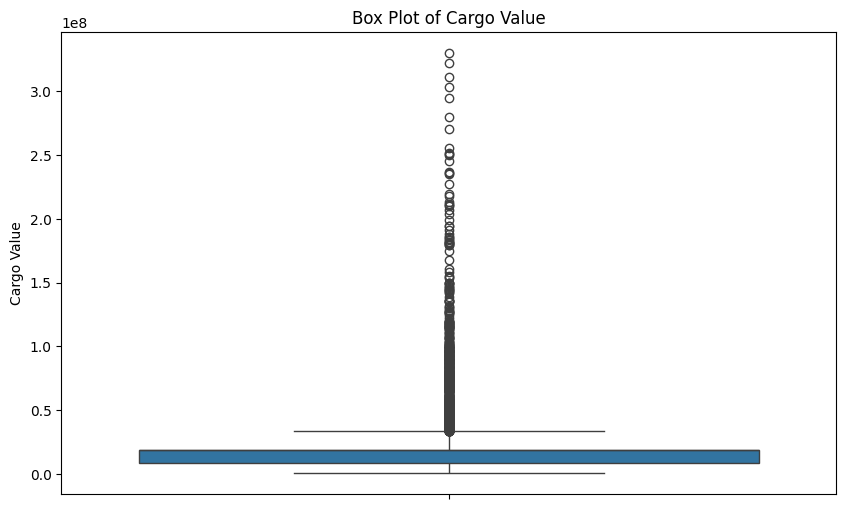

In [ ]:
# Cargo value analytics
# Box plot
plt.figure(figsize=(10, 6))  # Adjust figure size if needed
sns.boxplot(y=Bulk_PA['cargo_value'])
plt.title('Box Plot of Cargo Value')
plt.ylabel('Cargo Value')
plt.show()

In [ ]:
Bulk_PA

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,5.019118e+06
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,3.771151e+08,2.038345e+07,3.040235e+06,42224.579360,400.538755,4356.492000,37868.087360,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,1.206650e+06
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,5.530144e+08,4.796344e+07,1.508180e+07,111108.555800,616.059661,7549.750000,103558.805800,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,5.213458e+06
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,4.471519e+08,2.757838e+07,6.145678e+06,53915.680010,480.875986,6947.151000,46968.529010,6947.151000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,E

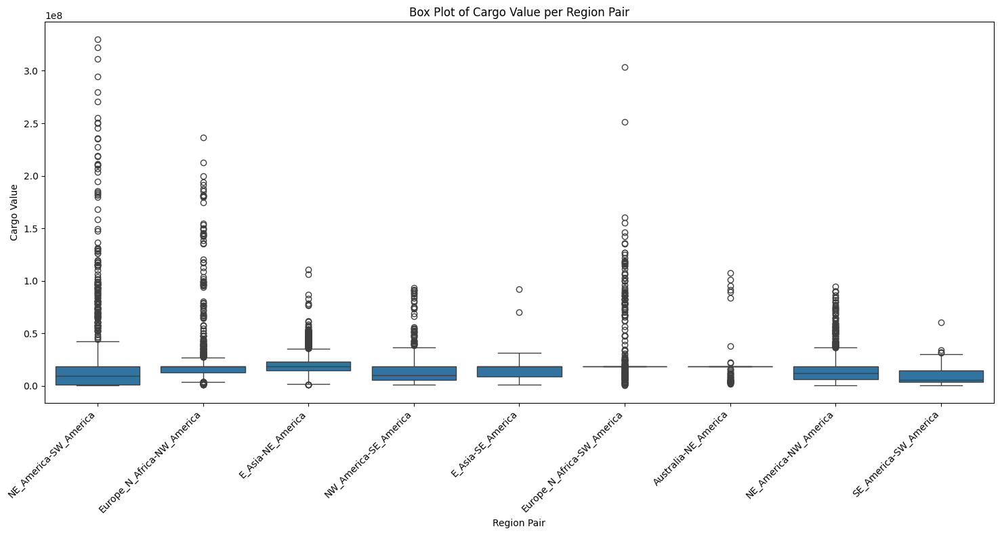

In [ ]:
# Cargo value box plot per region pair
plt.figure(figsize=(15, 8))  # Adjust figure size as needed
sns.boxplot(x='region_pairs', y='cargo_value', data=Bulk_PA)
plt.title('Box Plot of Cargo Value per Region Pair')
plt.xlabel('Region Pair')
plt.ylabel('Cargo Value')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust layout to prevent labels from overlapping
plt.show()

In [ ]:
Bulk_PA['cargo_value'].describe()

,cargo_value
count,1.106700e+04
mean,1.860352e+07
std,2.036395e+07
min,5.484600e+05
25%,8.713947e+06
50%,1.860352e+07
75%,1.860352e+07
max,3.300140e+08


In [ ]:
# Cargo value in descending order
Bulk_PA.sort_values(by=['cargo_value'], ascending=False).head(20)

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value
5907,West Coast South America,Chile,Mejillones,10.0,2021-11-06 15:24:52,2021-11-08,USG,USA,Panama City (US),6.7,2021-12-07,2021-12-11 15:08:42,Copper Cathodes,Breakbulk,9690901,39758,AFRICAN NIGHTJAR,Bulk Carrier,14.7,10.700,1,3.3,89.7196,33921,12.84,87.35,14.43,839.733333,432.200000,Panama City (US),0.000000,2.301438e+08,2.968090e+07,1.864303e+07,3641.564689,278.467706,5549.448000,-1907.883311,3641.564689,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2021-11,-0.98,-0.81,-0.67,-0.49,26.765301,26.441892,26.361746,26.339243,494.500000,157.48,551.04,248.719150,379.45,153.13,9728.90,442.63,818.354944,900.50,806.88,3311.27,273.90,387.600,1056.0,626.40,160.0,25.0,3.300140e+08
6090,West Coast South America,Chile,Mejillones,9.9,2021-12-08 09:41:28,2021-12-16,USG,USA,New Orleans,6.4,2022-01-13,2022-01-19 10:37:37,Copper Cathodes,Breakbulk,9780964,38581,LILAC HARMONY,Bulk Carrier,14.0,10.479,1,3.5,94.4747,33747,11.99,85.64,14.06,1008.933333,502.216667,New Orleans,0.000000,1.044499e+08,1.421988e+07,7.373572e+06,1414.331676,126.043349,6021.577833,-4607.246157,1414.331676,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2021-12,-0.98,-0.98,-0.81,-0.67,27.025141,26.765301,26.441892,26.361746,467.543478,169.65,554.14,264.537213,376.81,176.67,9551.18,461.66,809.316002,890.00,807.50,3399.21,291.39,308.025,1541.0,682.20,170.0,25.0,3.223237e+08
6862,West Coast South America,Chile,Mejillones,9.6,2022-04-16 00:16:44,2022-04-21,USG,USA,Panama City (US),6.5,2022-05-05,2022-05-11 20:02:56,Copper Cathodes,Breakbulk,9894612,37662,NORD DUBAI,Bulk Carrier,14.7,10.540,0,3.1,91.0816,30635,13.95,94.90,15.41,619.766667,330.616667,Panama City (US),0.000000,2.387576e+08,1.633615e+07,4.204422e+06,3179.321714,259.298192,4612.102500,-1432.780786,3179.321714,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2022-04,-1.06,-0.99,-0.93,-0.97,25.913893,25.994622,26.168822,26.666165,724.119048,310.85,720.79,348.166655,495.28,249.50,10161.38,579.45,813.504780,925.00,1202.00,4360.43,355.19,448.500,780.0,772.80,230.0,25.0,3.112939e+08
9520,West Coast South America,Chile,Mejillones,10.2,2023-07-18 01:51:52,2023-07-18,Antwerp Rotterdam Amsterdam Ghent,Belgium,Antwerp,7.2,2023-08-25,2023-08-28 10:45:15,Copper Cathodes,Breakbulk,9855460,39493,HAMBURG TEAM,Bulk Carrier,13.7,10.500,1,3.0,97.1429,35799,11.31,82.55,13.97,992.883333,867.450000,Antwerp,0.000000,4.213522e+08,4.426273e+07,1.297417e+07,7171.386378,478.589099,9810.859500,-2639.473122,7171.386378,0,0,0,1,0,0,0,0

## **Canal fee**

In order to calculate the canal passage fee, we must estimate the Vessel length over all (LOA) and the beam length.
We use S. C Misra (2016) p 115 for Length Between Perpendiculars (LBP) estimation. To convert LBP to LOA, a multiplier of 1.04 is used from Tsujimoto et al (2019). FInally, for beam estimation, a function containing LOA is used from Misra (2016) p.116. An alternative version could be seen in https://www.yumpu.com/en/document/view/11297041/empirical-ship-formula
Canal fee data was retreived directly from the Panam Canal Authority website. https://pancanal.com/wp-content/uploads/2024/09/PP-Lista-tarifas-consolidado-final-ingles.pdf; Additional documentation was used to clarify some of the passage fees:
*   Vessel type and unit of surcharge calculation: https://pancanal.com/wp-content/uploads/2022/09/Approved-Tolls-FY23_24_25-for-website_rev-6Sep2022-1.pdf; Note: For dry bulk carriers, DWT is the unit of estimating the calculation of tolls.
*   Line handlers and locomotives: https://pancanal.com/wp-content/uploads/2021/08/ENGLISH-FAQ-OMS-2024.pdf
*   Fresh water surcharge: https://pancanal.com/wp-content/uploads/2021/08/Notes-on-tolls-maritime-tariffs-April-2025.pdf; Note, for practical purposes, the variable part is estimated on the monthly water level average on the transit month rather than the previous day of passage. This change is not significant as this cost varies between 1 and 10%. As the water level change is gradual over a month, the average of a month is considered as a good enogh proxy.
Finally, to verify the validity of the calculation, the toll calculator from Wilhelmsen was used: https://www.wilhelmsen.com/tollcalculators/panama-toll-calculator/.
Note, the canal toll fee includes only mandatory elements and do not include optional services.

In [ ]:
# Adjust the voyage draft of the vessels if it is larger than the maximum draft of the vessel
# so to reduce human input and AIS errors and better represent the toll fees
for index, row in Bulk_PA.iterrows():
    if row['load_draft'] > row['vsl_max_draft']:
        Bulk_PA.loc[index, 'load_draft'] = row['vsl_max_draft']

In [ ]:
1 # Add vsl displacement
#Bulk_PA['vsl_displacement'] = np.nan

# Add vsl length
Bulk_PA['vsl_LOA'] = np.nan
Bulk_PA['vsl_LOA'] = 1.04*6.667*Bulk_PA['vsl_dwt']**0.308

# Add vsl beam
Bulk_PA['vsl_beam'] = np.nan
Bulk_PA['vsl_beam'] = 0.164*(6.667*Bulk_PA['vsl_dwt']**0.308)+0.090

In [ ]:
# Round vessel dimensions to make it more realistic. No vessle will be 10 cm larger than the Panamax locks, \
# as it will be unreasonable from an economic point of view as the toll is much larger
# Round vsl_beam to 32.3 if it's between 32 and 33.5
Bulk_PA.loc[(Bulk_PA['vsl_beam'] >= 32) & (Bulk_PA['vsl_beam'] <= 33.5), 'vsl_beam'] = 32.3

# Round vsl_LOA to 294 if it's between 293 and 295
Bulk_PA.loc[(Bulk_PA['vsl_LOA'] >= 293) & (Bulk_PA['vsl_LOA'] <= 295), 'vsl_LOA'] = 294

In [ ]:
# Estimate the ship size according to PCA definition
# Add ship size
Bulk_PA['vsl_ship_size'] = np.nan
# Define a function to categorize vessels
def categorize_vessel(row):
    if row['vsl_beam'] > 32.61 or row['vsl_LOA'] > 294.44 or row['load_draft'] >= 12.12:
        return 'Neopanamax'
    elif row['vsl_beam'] < 27.74:
        return 'Regular'
    elif row['vsl_beam'] >= 27.74:
        return 'Super'
    else:
        return None  # Or handle cases that don't match any category

# Apply the function to create the 'vsl_ship_size' column
Bulk_PA['vsl_ship_size'] = Bulk_PA.apply(categorize_vessel, axis=1)

In [ ]:
# Canal fee estimation
import math
# Create a Canal fee column
Bulk_PA['canal_fee'] = np.nan

def calculate_panama_canal_fee(vessel_type: str, dwt: float, loa: float, beam: float, draft: float, water_level_m: float, laden: bool = True) -> float:
    """
    Estimate Panama Canal transit cost based on 2024 tariffs, with dynamic fresh water surcharge and updated ancillary fees.
    Returns the total estimated cost in USD.
    """
    # Fixed toll and DWT tariffs
    fixed_fee = {
        'Regular': 60000,
        'Super': 100000,
        'Neopanamax': 300000
    }

    capacity_tariff = {
        'Regular': 1.25,
        'Super': 1.15,
        'Neopanamax': 0.50
    }

    if vessel_type not in fixed_fee:
        raise ValueError(f"Unknown vessel type: {vessel_type}")

    # Tug assistance based on size
    if vessel_type == 'Neopanamax':
        tug_assistance = 30000
    elif 213.36 <= loa <= 294.44 or beam <= 32.61:
        tug_assistance = 11600
    elif loa < 213.36 and 24.38 <= beam <= 27.73:
        tug_assistance = 7000
    elif loa < 173.74 and beam < 24.38:
        tug_assistance = 5000
    else:
        raise ValueError(f"Unmatched tug assistance rule for vessel_type={vessel_type}, LOA={loa}, Beam={beam}")

    # Linehandlers cost
    if vessel_type == 'Neopanamax':
        num_linehandlers = 12
        linehandler_cost_per = 325
    elif loa > 259 and draft >= 10.97:
        num_linehandlers = 24
        linehandler_cost_per = 270
    elif loa > 182.9 or dwt > 30000:
        num_linehandlers = 19
        linehandler_cost_per = 270
    elif 152.4 < loa <= 182.8 or 22000 < dwt <= 30000:
        num_linehandlers = 14
        linehandler_cost_per = 270
    elif 38.1  < loa <= 173.7 or 12000 < dwt <= 22000:
        num_linehandlers = 14
        linehandler_cost_per = 270
    else:
        raise ValueError(f"Unmatched linehandler rule for vessel_type={vessel_type}, LOA={loa}, DWT={dwt}, Draft={draft}")

    linehandlers_total = num_linehandlers * linehandler_cost_per

    # Locomotive wire cost
    if vessel_type == 'Neopanamax':
        locomotive_cost = 0
    elif num_linehandlers == 11:
        locomotive_cost = 4 * 500
    elif num_linehandlers in [12, 14]:
        locomotive_cost = 8 * 500
    elif num_linehandlers == 19:
        locomotive_cost = 12 * 500
    elif num_linehandlers == 24:
        locomotive_cost = 16 * 500
    else:
        raise ValueError(f"Unmatched locomotive wire rule for linehandlers={num_linehandlers}")

    # Base toll
    fixed = fixed_fee[vessel_type]
    capacity = capacity_tariff[vessel_type] * dwt
    base_toll = fixed + capacity

    # Fresh water surcharge variable component (as % of base toll) if transit month starts from 01-2024
    if row['proxy_transit_month'] <= pd.Period('2024-01', freq='M'):
      freshwater_variable_pct = 0.1 / (1 + math.exp(0.6 * ((water_level_m * 3.280839895) - 79)))
      freshwater_variable = freshwater_variable_pct * base_toll
    else:
      freshwater_variable = 0

    # Other mandatory costs (tug, linehandlers, locomotives already included)
    ancillary_fees = {
        "Canal Inspection": 670,
        "Security Surcharge": 1250,
        "Fresh Water Surcharge": 10000 + freshwater_variable
    }

    ancillary_total = tug_assistance + linehandlers_total + locomotive_cost + sum(ancillary_fees.values())
    grand_total = base_toll + ancillary_total
    return grand_total

# Apply to DataFrame
Bulk_PA['canal_fee'] = Bulk_PA.apply(
    lambda row: calculate_panama_canal_fee(
        row['vsl_ship_size'], row['vsl_dwt'], row['vsl_LOA'], row['vsl_beam'], row['load_draft'], row['water_level_m']
    ), axis=1
)


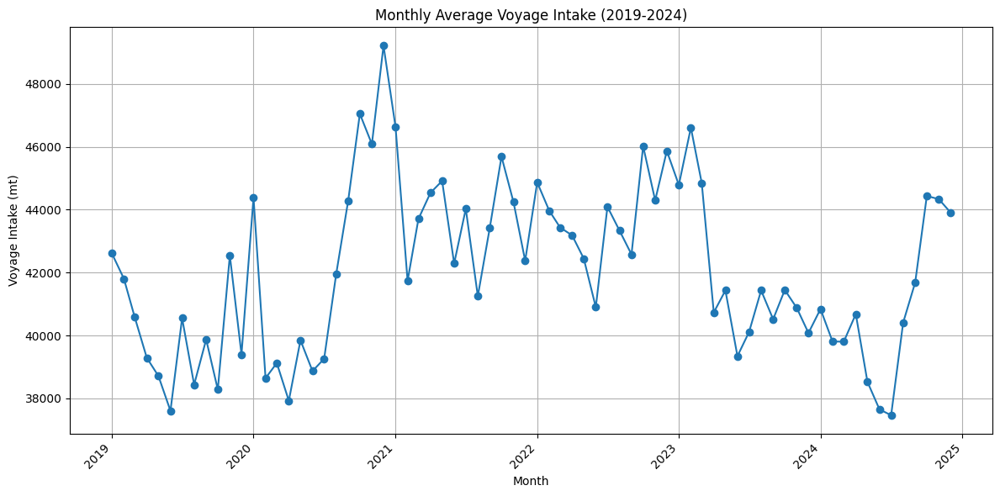

In [ ]:
# Graph of voyage intake distribution
# Group by proxy_transit_month and calculate the mean of voy_intake_mt
monthly_average_intake = Bulk_PA.groupby('proxy_transit_month')['voy_intake_mt'].mean()

# Convert the Period objects to datetime objects for plotting
monthly_average_intake.index = monthly_average_intake.index.to_timestamp()

# Create the plot
plt.figure(figsize=(12, 6))
plt.plot(monthly_average_intake.index, monthly_average_intake.values, marker='o')
plt.xlabel('Month')
plt.ylabel('Voyage Intake (mt)')
plt.title('Monthly Average Voyage Intake (2019-2024)')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
Bulk_PA

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value,vsl_LOA,vsl_beam,vsl_ship_size,canal_fee
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,5.019118e+06,197.155331,31.179879,Super,195041.10
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,3.771151e+08,2.038345e+07,3.040235e+06,42224.579360,400.538755,4356.492000,37868.087360,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.910,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,1.206650e+06,203.249933,32.300000,Super,201315.50
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,5.530144e+08,4.796344e+07,1.508180e+07,111108.555800,616.059661,7549.750000,103558.805800,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.600,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.5,5939.10,362.010000,563.721334,260.0,215.5,2569.70,273.90,185.15,694.0,534.94,90.0,25.0,5.213458e+06,209.137924,32.300000,Neopanamax,377621.00
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,4.

In [ ]:
# Create a copy of the original DataFrame
Bulk_PA_ratio = Bulk_PA.copy()

# Calculate the load ratio and assign it to a new column
Bulk_PA_ratio['load_ratio'] = Bulk_PA_ratio['voy_intake_mt'] / Bulk_PA_ratio['vsl_dwt']

# Display the new DataFrame with the load ratio column
Bulk_PA_ratio.describe()

,load_draft,load_start_date,load_end_date,discharge_draft,discharge_start_date,discharge_end_date,imo,vsl_dwt,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value,vsl_LOA,vsl_beam,canal_fee,load_ratio
count,11067.000000,11067,11067,11067.000000,11067,11067,1.106700e+04,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,10482.000000,11067.000000,11067.000000,11067.000000,11067.000000,1.035100e+04,1.036700e+04,1.036700e+04,1.036700e+04,10351.000000,11067.000000,1.036700e+04,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.0,1.106700e+04,11067.000000,11067.000000,11067.000000,11067.000000
mean,10.955675,2021-09-17 12:11:39.513147392,2021-09-20 06:19:56.421794304,6.668998,2021-10-24 07:58:49.737056256,2021-10-29 02:44:27.589410048,9.602697e+06,51012.356465,13.802170,11.898473,0.307852,4.345159,91.731737,42326.448993,11.913320,82.068088,14.910204,998.751507,715.835564,13.453431,5.038783e+08,4.645832e+07,1.151836e+07,7.712515e+04,561.850182,8489.347481,6.858584e+04,6705.113734,0.401916,0.137165,0.107798,0.145749,0.123249,0.076172,0.007952,0.274600,0.169332,0.025481,0.153429,0.256799,0.114033,0.006325,6771.986717,21.704812,13255.522409,42.486019,6483.535692,20.781207,145.811222,-0.213881,-0.211521,-0.202365,-0.189632,25.735385,25.756514,25.774689,25.784529,449.866807,160.305317,521.802032,231.670517,303.036962,170.273789,7927.290148,461.398181,723.153408,403.028824,452.946366,2820.351977,334.223863,272.100168,921.132556,586.377397,124.835999,25.0,1.860352e+07,190.890756,30.085869,219437.217353,0.833873
min,5.200000,2019-01-01 06:07:01,2019-01-03 00:00:00,0.000000,2019-01-11 00:00:00,2019-01-18 00:27:16,1.013688e+06,3009.000000,0.000000,5.360000,0.000000,0.100000,58.130900,2428.000000,5.920000,8.060000,8.740000,156.866667,46.483333,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,608.899333,-1.428775e+04,608.899333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2021.000000,6.475000,8764.000000,28.090000,2984.000000,9.570000,37.193070,-1.270000,-1.270000,-1.270000,-1.270000,24.235156,24.235156,24.235156,24.235156,192.340909,50.140000,339.810000,143.905787,181.146293,70.750000,5057.970000,333.130000,563.721334,201.900000,215.500000,1903.370000,240.570000,142.030000,468.000000,412.160000,50.000000,25.0,5.484600e+05,81.718019,12.976303,95061.250000,0.349990
25%,10.000000,2020-05-05 01:18:48,2020-05-08 00:00:00,6.200000,2020-06-08 00:0

In [ ]:
Bulk_PA_ratio.sort_values(by=['load_ratio'], ascending=True)

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value,vsl_LOA,vsl_beam,vsl_ship_size,canal_fee,load_ratio
8080,Baltic,Sweden,Uddevalla,7.10,2022-11-10 12:44:09,2022-11-14,West Coast Central America,Mexico,Guaymas,5.5,2022-12-18,2022-12-20 22:26:45,None,None,9240548,10526,MARGARETHA,Open Hatch Carrier,15.0,7.670,0,1.6,92.5684,3684,10.81,72.07,13.70,969.716667,801.683333,Guaymas,0.000000,2.221316e+08,6.864200e+07,3.052015e+06,6564.192802,293.825634,8666.196833,-2102.004032,6564.192802,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.60,5539.0,17.755,68.683737,Cape Horn,2022-11,-0.92,-0.99,-1.01,-0.91,26.870558,26.615923,26.569111,26.644731,484.204545,342.16,648.92,320.920062,422.680000,300.00,8049.86,518.68,792.340428,588.75,563.13,2938.92,666.16,466.48,1069.0,524.30,190.0,25.0,1.860352e+07,120.176876,19.040969,Regular,104457.50,0.349990
2720,Far East,China,Tianjin,8.30,2020-04-25 08:59:26,2020-04-30,North Coast South America,Colombia,Barranquilla,7.3,2020-06-10,2020-06-13 20:47:43,Steels,Steels,9852664,63481,SANTA TERESA,Bulk Carrier,14.5,13.418,1,1.0,58.1309,25568,12.36,85.24,14.93,1187.800000,851.933333,Barranquilla,18.533333,6.114999e+08,7.136669e+07,1.171083e+07,9402.611419,694.577452,10529.896000,-1127.284581,9402.611419,0,0,0,0,1,0,0,0,0,1,0,0,0,0,E_Asia_to_SE_America,E_Asia-SE_America,8463.0,27.130,14312.0,45.87,5849.0,18.740,69.112608,Cape of Good Hope,2020-04,0.19,0.40,0.48,0.50,24.606910,24.788007,25.188146,25.592483,192.340909,58.55,361.26,146.909566,218.992273,70.75,5057.97,363.83,573.642124,235.00,220.38,1903.37,252.89,172.83,513.0,490.84,60.0,25.0,1.254980e+07,209.015297,32.300000,Super,207653.15,0.402766
8117,USG,USA,Houston,5.70,2022-11-20 03:28:45,2022-11-24,West Coast South America,Chile,Iquique,4.9,2022-12-14,2022-12-15 01:02:53,General Cargo,Bulk,9407586,10340,BBC KIMBERLEY,Heavy Lift Cargo Vessel,16.0,7.715,1,0.8,73.8820,4274,13.57,84.81,15.54,597.566667,362.616667,Iquique,0.000000,9.869202e+07,2.432843e+07,5.060926e+06,2040.212400,128.081381,4920.708167,-2880.495766,2040.212400,1,0,0,0,0,0,0,0,0,0,1,0,0,0,NE_America_to_SW_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2022-11,-0.92,-0.99,-1.01,-0.91,26.870558,26.615923,26.569111,26.644731,484.204545,342.16,648.92,320.920062,422.680000,300.00,8049.86,518.68,792.340428,588.75,563.13,2938.92,666.16,466.48,1069.0,524.30,190.0,25.0,1.860352e+07,119.518771,18.937191,Regular,104225.00,0.413346
1595,Great Lakes,USA,Monroe,6.80,2019-10-05 15:20:45,2019-10-11,West Coast South America,Peru,Salaverry,5.9,2019-11-03,2019-11-07 21:13:51,None,None,9139311,12950,HAPPY RANGER,Heavy Lift Cargo Vessel,16.0,9.500,0,0.9,71.5789,5552,13.19,82.44,16.29,797.883333,531.100000,Salave

In [ ]:
none_count = Bulk_PA['commodity'].isnull().sum()
print(f"Number of 'None' values in 'commodity': {none_count}")

Number of 'None' values in 'commodity': 280


In [ ]:
# Group by 'proxy_transit_month' and count null values in 'commodity'
none_counts_per_month = Bulk_PA.groupby('proxy_transit_month')['commodity'].apply(lambda x: x.isnull().sum()).reset_index(name='none_count')

# Display the result
#show all rows
pd.set_option('display.max_rows', None)
print(none_counts_per_month)

   proxy_transit_month  none_count
0              2019-01           4
1              2019-02           7
2              2019-03           7
3              2019-04           5
4              2019-05           4
5              2019-06           2
6              2019-07           2
7              2019-08           6
8              2019-09           8
9              2019-10           7
10             2019-11           5
11             2019-12           7
12             2020-01           4
13             2020-02           8
14             2020-03           5
15             2020-04           5
16             2020-05           4
17             2020-06           5
18             2020-07           8
19             2020-08           3
20             2020-09           6
21             2020-10           8
22             2020-11           6
23             2020-12           2
24             2021-01           3
25             2021-02           8
26             2021-03           5
27             2021-

In [ ]:
# Stop showing all rows
pd.reset_option('display.max_rows')
Bulk_PA.describe()

,load_draft,load_start_date,load_end_date,discharge_draft,discharge_start_date,discharge_end_date,imo,vsl_dwt,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value,vsl_LOA,vsl_beam,canal_fee
count,11067.000000,11067,11067,11067.000000,11067,11067,1.106700e+04,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,10482.000000,11067.000000,11067.000000,11067.000000,11067.000000,1.035100e+04,1.036700e+04,1.036700e+04,1.036700e+04,10351.000000,11067.000000,1.036700e+04,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.000000,11067.0,1.106700e+04,11067.000000,11067.000000,11067.000000
mean,10.955675,2021-09-17 12:11:39.513147392,2021-09-20 06:19:56.421794304,6.668998,2021-10-24 07:58:49.737056256,2021-10-29 02:44:27.589410048,9.602697e+06,51012.356465,13.802170,11.898473,0.307852,4.345159,91.731737,42326.448993,11.913320,82.068088,14.910204,998.751507,715.835564,13.453431,5.038783e+08,4.645832e+07,1.151836e+07,7.712515e+04,561.850182,8489.347481,6.858584e+04,6705.113734,0.401916,0.137165,0.107798,0.145749,0.123249,0.076172,0.007952,0.274600,0.169332,0.025481,0.153429,0.256799,0.114033,0.006325,6771.986717,21.704812,13255.522409,42.486019,6483.535692,20.781207,145.811222,-0.213881,-0.211521,-0.202365,-0.189632,25.735385,25.756514,25.774689,25.784529,449.866807,160.305317,521.802032,231.670517,303.036962,170.273789,7927.290148,461.398181,723.153408,403.028824,452.946366,2820.351977,334.223863,272.100168,921.132556,586.377397,124.835999,25.0,1.860352e+07,190.890756,30.085869,219437.217353
min,5.200000,2019-01-01 06:07:01,2019-01-03 00:00:00,0.000000,2019-01-11 00:00:00,2019-01-18 00:27:16,1.013688e+06,3009.000000,0.000000,5.360000,0.000000,0.100000,58.130900,2428.000000,5.920000,8.060000,8.740000,156.866667,46.483333,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,608.899333,-1.428775e+04,608.899333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2021.000000,6.475000,8764.000000,28.090000,2984.000000,9.570000,37.193070,-1.270000,-1.270000,-1.270000,-1.270000,24.235156,24.235156,24.235156,24.235156,192.340909,50.140000,339.810000,143.905787,181.146293,70.750000,5057.970000,333.130000,563.721334,201.900000,215.500000,1903.370000,240.570000,142.030000,468.000000,412.160000,50.000000,25.0,5.484600e+05,81.718019,12.976303,95061.250000
25%,10.000000,2020-05-05 01:18:48,2020-05-08 00:00:00,6.200000,2020-06-08 00:00:00,2020-06-13 06:46:44.500000,9.476692e+

In [ ]:
# List the frequency of each vessel size
Bulk_PA['vsl_ship_size'].value_counts()

,count
vsl_ship_size,
Super,6015
Regular,2616
Neopanamax,2436


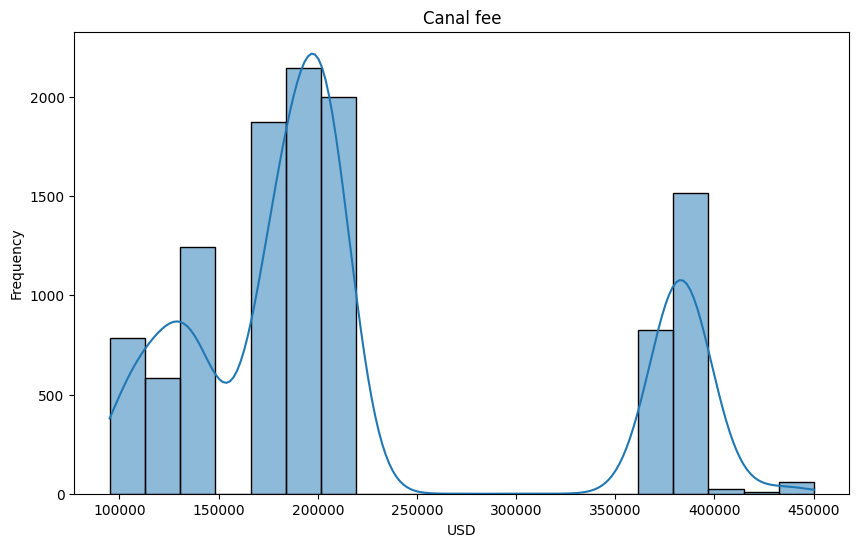

In [ ]:
# DWT distribution
plt.figure(figsize=(10, 6))  # Adjust figure size if needed
sns.histplot(Bulk_PA['canal_fee'], bins=20, kde=True)
plt.title('Canal fee')
plt.xlabel('USD')
plt.ylabel('Frequency')
plt.show()

This dataset will help us to structure the dataset for our linear regression models

In [ ]:
# Extract the final dataset for machine learning
Bulk_PA.to_parquet('Bulk_PA_final.parquet')

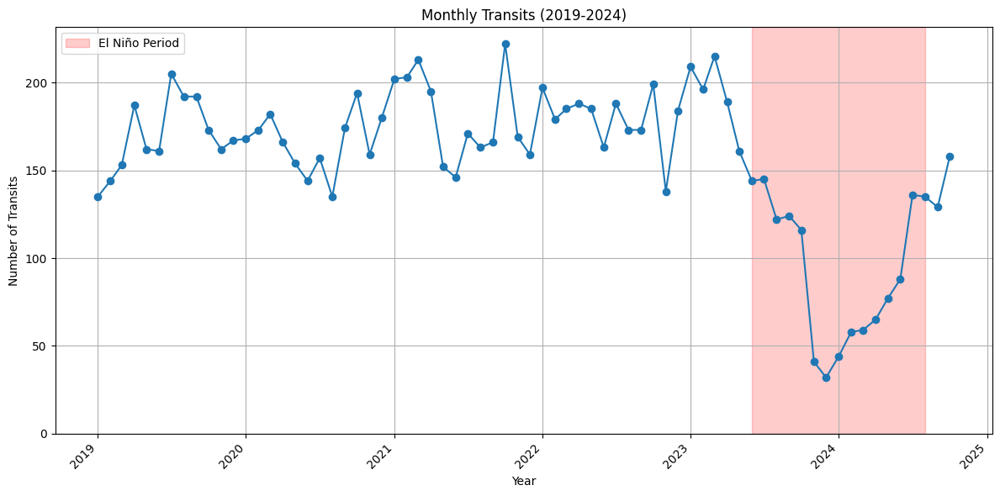

In [ ]:
# Scatter plot the number of monthly transits & highlight the El Nino period
monthly_counts = Bulk_PA.groupby('proxy_transit_month').size().reset_index(name='count')

# Filter data to be between 2019 and 2025
# Explicitly create a copy after filtering
monthly_counts_filtered = monthly_counts[(monthly_counts['proxy_transit_month'] >= '2019-01') & (monthly_counts['proxy_transit_month'] <= '2024-10')].copy()

# Convert the Period objects to datetime objects for plotting
monthly_counts_filtered['proxy_transit_month'] = monthly_counts_filtered['proxy_transit_month'].dt.to_timestamp()

# Create plot
plt.figure(figsize=(12, 6))
plt.plot(monthly_counts_filtered['proxy_transit_month'], monthly_counts_filtered['count'], marker='o')
plt.xlabel('Year')
plt.ylabel('Number of Transits')
plt.title('Monthly Transits (2019-2024)')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.ylim(bottom=0)

# Highlight the El Niño period (June 2023 to August 2024)
el_nino_start = pd.to_datetime('2023-06')
el_nino_end = pd.to_datetime('2024-08')
plt.axvspan(el_nino_start, el_nino_end, color='red', alpha=0.2, label='El Niño Period')

plt.legend()
plt.show()

# **Dataset preparation**

## **Commodity group categorization**

In [ ]:
# Display the commodity groups with percentage and cumulative percentage in descending order
# Same table as shown before
display(commodity_groups)

,commodity_group,count,percentage,cumulative_percentage
0,Grain,3345,31.01%,31.01%
1,Bulk,2787,25.84%,56.85%
2,Fertilizers,1216,11.27%,68.12%
3,Steels,1163,10.78%,78.90%
4,Coal,1030,9.55%,88.45%
5,Agriprods,461,4.27%,92.72%
6,Breakbulk,404,3.75%,96.47%
7,Pellets Group,137,1.27%,97.74%
8,Project Cargoes,127,1.18%,98.92%
9,Iron Ore,84,0.78%,99.69%


As the top five commodity groups cover over 88% of the transits, they are sufficient for our further analysis. It allows to reduce dimensionality and all categories now contain sufficient number of observations for multiple linear regression.

In [ ]:
# Create a new variable to categorise the commodities in 6 groups
top5_groups = ['Grain', 'Bulk', 'Steels', 'Fertilizers', 'Coal']

Bulk_PA['commodity_group_top5'] = Bulk_PA['commodity_group'].apply(lambda x: x if x in top5_groups else 'Others')
Bulk_PA.head()

,load_zone,load_country,load_port,load_draft,load_start_date,load_end_date,discharge_zone,discharge_country,discharge_port,discharge_draft,discharge_start_date,discharge_end_date,commodity,commodity_group,imo,vsl_dwt,vsl_name,vsl_type,vsl_max_speed,vsl_max_draft,has_part_voy,voy_draft_diff,voy_load_draft_ratio,voy_intake_mt,voy_avg_speed,voy_speed_ratio,voy_top_speed,voy_duration_h,voy_sea_duration_h,voy_ais_destination,blackout_duration_h,me_con_g,ae_con_g,ab_con_g,distance,fuel_consumption_mt,proxy_distance,distance_difference,distance_94,load_NE_America,load_NW_America,load_SE_America,load_SW_America,load_E_Asia,load_Europe_N_Africa,load_Australia,disch_NE_America,disch_NW_America,disch_SE_America,disch_SW_America,disch_E_Asia,disch_Europe_N_Africa,disch_Australia,OD_region,region_pairs,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,rerouting (%),route,proxy_transit_month,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,cargo_value,vsl_LOA,vsl_beam,vsl_ship_size,canal_fee,commodity_group_top5
0,West Coast South America,Peru,Bayovar,12.04,2019-01-03 15:58:12,2019-01-03,USG,USA,Manatee,6.1,2019-01-15,2019-01-21 09:18:49,Phosphate Rock,Fertilizers,9240811,52514,MARIA F,Bulk Carrier,14.5,12.040,0,5.94,100.0000,48967,12.55,86.55,13.49,425.350000,266.933333,Manatee,171.916667,NaN,NaN,NaN,NaN,NaN,3350.013333,NaN,3350.013333,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.9,0.76,26.188514,26.786906,26.810513,26.664789,406.0,98.56,381.96,166.743164,209.806356,102.5,5939.1,362.01,563.721334,260.0,215.5,2569.7,273.9,185.15,694.0,534.94,90.0,25.0,5.019118e+06,197.155331,31.179879,Super,195041.10,Fertilizers
1,West Coast South America,Chile,Puerto Patache,11.80,2019-01-01 17:56:12,2019-01-03,East Coast U.S,USA,New York,6.5,2019-01-21,2019-01-24 00:48:47,Salt,Bulk,9490832,57970,Genco Rhone,Bulk Carrier,14.3,12.950,0,5.30,91.1197,48266,11.16,78.04,13.23,534.883333,390.366667,New York,0.000000,377115073.2,20383447.50,3.040235e+06,42224.57936,400.538755,4356.492000,37868.08736,4356.492000,0,0,0,1,0,0,0,1,0,0,0,0,0,0,SW_America_to_NE_America,NE_America-SW_America,2940.0,9.425,10267.5,32.91,7327.5,23.485,249.234694,Cape Horn,2019-01,0.75,0.81,0.9,0.76,26.188514,26.786906,26.810513,26.664789,406.0,98.56,381.96,166.743164,209.806356,102.5,5939.1,362.01,563.721334,260.0,215.5,2569.7,273.9,185.15,694.0,534.94,90.0,25.0,1.206650e+06,203.249933,32.300000,Super,201315.50,Bulk
2,North West Africa,Morocco,Casablanca,12.20,2019-01-01 06:07:01,2019-01-03,West Coast Central America,Mexico,Lazaro Cardenas,6.9,2019-01-29,2019-02-02 03:19:16,Phosphate Rock,Fertilizers,9801249,63602,BELNIPPON,Bulk Carrier,14.5,13.418,0,5.30,88.6868,50863,13.13,90.55,15.50,765.200000,575.000000,Lazaro Cardenas,0.000000,553014417.3,47963444.75,1.508180e+07,111108.55580,616.059661,7549.750000,103558.80580,7549.750000,0,0,0,0,0,1,0,0,1,0,0,0,0,0,Europe_N_Africa_to_NW_America,Europe_N_Africa-NW_America,8064.5,25.845,13603.5,43.60,5539.0,17.755,68.683737,Cape Horn,2019-01,0.75,0.81,0.9,0.76,26.188514,26.786906,26.810513,26.664789,406.0,98.56,381.96,166.743164,209.806356,102.5,5939.1,362.01,563.721334,260.0,215.5,2569.7,273.9,185.15,694.0,534.94,90.0,25.0,5.213458e+06,209.137924,32.300000,Neopanamax,377621.00,Fertilizers
3,West Mediterranean,Spain,Barcelona,10.90,2019-01-01 19:39:22,2019-01-04,West Coast Central America,Costa Rica,Caldera (Costa Rica),6.3,2019-01-31,2019-02-02 10:46:45,Clinker,Breakbulk,9692727,55757,AQUAVITA BAY,Bulk Carrier,14.5,12.735,0,4.60,85.5909,42697,11.67,80.48,14.02,759.116667,595.300000,Caldera (Costa Rica),0.000000,447151929.9,27

In [ ]:
# Commodity groups distribution per region pair

# Assuming 'Bulk_PA' is your original DataFrame
new_df = Bulk_PA[['proxy_transit_month', 'commodity_group_top5', 'commodity_group', 'commodity', 'region_pairs']].copy()

# Group by 'commodity_group_top5' and 'region_pairs'
grouped_df = new_df.groupby(['commodity_group_top5', 'region_pairs'])

# Calculate size, unstack, and reset index to get the desired output
result_df = grouped_df.size().unstack(fill_value=0).reset_index()

# Display the resulting DataFrame
result_df

region_pairs,commodity_group_top5,Australia-NE_America,E_Asia-NE_America,E_Asia-SE_America,Europe_N_Africa-NW_America,Europe_N_Africa-SW_America,NE_America-NW_America,NE_America-SW_America,NW_America-SE_America,SE_America-SW_America
0,Bulk,72,832,191,217,338,260,804,48,25
1,Coal,2,158,73,159,33,11,30,265,299
2,Fertilizers,13,45,6,370,252,61,365,67,37
3,Grain,33,1611,4,276,22,653,507,221,18
4,Others,20,498,82,245,60,210,362,21,28
5,Steels,18,674,32,69,64,187,61,52,6


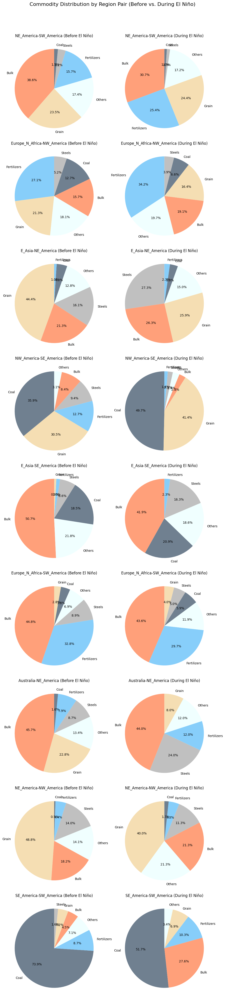

In [ ]:
import math
from matplotlib.lines import Line2D
# Create pie charts for the distribution of commodity groups per region pair before and during El Nino
# Filter data before June 2023
before_el_nino = Bulk_PA[Bulk_PA['proxy_transit_month'] < pd.Period('2023-06', freq='M')].copy()

# Filter data during El Niño (June 2023 to August 2024 as per your previous code)
during_el_nino = Bulk_PA[(Bulk_PA['proxy_transit_month'] >= pd.Period('2023-06', freq='M')) & (Bulk_PA['proxy_transit_month'] <= pd.Period('2024-09', freq='M'))].copy()


# Get unique region pairs present in either period
all_region_pairs = pd.concat([before_el_nino['region_pairs'], during_el_nino['region_pairs']]).unique()
n_regions = len(all_region_pairs)

# Define colors for each commodity group
commodity_colors = {
    'Grain': '#F5DEB3',
    'Bulk': '#FFA07A',
    'Steels': '#C0C0C0',
    'Fertilizers': '#87CEFA',
    'Coal': '#708090',
    'Others': '#F0FFFF'
}

# Set up the figure and axes for a 2xN grid (N rows, 2 columns for before/during)
cols = 2
rows = math.ceil(n_regions)

fig, axes = plt.subplots(rows, cols, figsize=(10, 5 * rows)) # Adjusted figsize

axes = axes.flatten() # Flatten the 2D array of axes for easy iteration

# Iterate through each region pair
for i, region_pair in enumerate(all_region_pairs):
    # Before El Niño pie chart
    ax_before = axes[i * cols]
    data_before = before_el_nino[before_el_nino['region_pairs'] == region_pair]
    dist_before = data_before['commodity_group_top5'].value_counts()
    colors_before = [commodity_colors.get(g, '#CCCCCC') for g in dist_before.index]

    if not dist_before.empty: # Check if there's data for this period
      ax_before.pie(
          dist_before,
          labels=dist_before.index,
          autopct='%1.1f%%',
          startangle=90,
          colors=colors_before
      )
    ax_before.set_title(f'{region_pair} (Before El Niño)')

    # During El Niño pie chart
    ax_during = axes[i * cols + 1]
    data_during = during_el_nino[during_el_nino['region_pairs'] == region_pair]
    dist_during = data_during['commodity_group_top5'].value_counts()
    colors_during = [commodity_colors.get(g, '#CCCCCC') for g in dist_during.index]

    if not dist_during.empty: # Check if there's data for this period
      ax_during.pie(
          dist_during,
          labels=dist_during.index,
          autopct='%1.1f%%',
          startangle=90,
          colors=colors_during
      )
    ax_during.set_title(f'{region_pair} (During El Niño)')


# Hide any unused subplots if the number of regions is odd
if n_regions * cols > len(axes):
    for j in range(n_regions * cols, len(axes)):
        fig.delaxes(axes[j])

# Overall title and layout
fig.suptitle('Commodity Distribution by Region Pair (Before vs. During El Niño)', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96]) # Adjust layout to make space for the super title

plt.show()

In [ ]:
# Commodity analysis - analyse in further details which segments were the most impacted and between which regions.
# Careful the timeframe is different: 53 months VS 15 months --> Should be modify to consider the monthly level.

def create_region_table(region_pair):
    # Filter data for the region pair
    region_data = Bulk_PA[Bulk_PA['region_pairs'] == region_pair]

    # Calculate transits before June 2023 at the monthly level
    before_june = region_data[region_data['proxy_transit_month'] < pd.Period('2023-06', freq='M')]
    before_counts1 = before_june['commodity_group_top5'].value_counts()
    before_counts = before_counts1/53
    before_total = before_counts.sum()
    before_percentages = (before_counts / before_total * 100).round(2)

    # Calculate transits after and including June 2023 at the monthly level
    after_june = region_data[region_data['proxy_transit_month'] >= pd.Period('2023-06', freq='M')]
    after_counts1 = after_june['commodity_group_top5'].value_counts()
    after_counts = after_counts1/19
    after_total = after_counts.sum()
    after_percentages = (after_counts / after_total * 100).round(2)

    # Get all unique commodity groups from both periods
    all_commodity_groups = before_counts.index.union(after_counts.index)

    # Reindex both series with all commodity groups, filling missing values with 0
    before_counts = before_counts.reindex(all_commodity_groups, fill_value=0)
    before_percentages = before_percentages.reindex(all_commodity_groups, fill_value=0)
    after_counts = after_counts.reindex(all_commodity_groups, fill_value=0)
    after_percentages = after_percentages.reindex(all_commodity_groups, fill_value=0)

    # Create the table
    table_data = {
        'Commodity Group': all_commodity_groups,
        'Before June Count': before_counts.values,
        'Before June %': before_percentages.values,
        'After June Count': after_counts.values,
        'After June %': after_percentages.values,
        '% point Change': ((after_percentages - before_percentages)).round(2)
    }
    table = pd.DataFrame(table_data)
    table.index = table['Commodity Group']
    table = table.drop(columns=['Commodity Group'])
    table = table.fillna(0)
    return table

# Get unique region pairs
region_pairs = Bulk_PA['region_pairs'].unique()

# Create and display tables for each region pair
for region_pair in region_pairs:
    region_table = create_region_table(region_pair)
    print(f"Table for {region_pair}:\n")
    display(region_table)
    print("\n")

Table for NE_America-SW_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,12.867925,38.60,6.421053,33.70,-4.90
Coal,0.509434,1.53,0.157895,0.83,-0.70
Fertilizers,5.245283,15.73,4.578947,24.03,8.30
Grain,7.849057,23.54,4.789474,25.14,1.60
Others,5.792453,17.37,2.894737,15.19,-2.18
Steels,1.075472,3.23,0.210526,1.10,-2.13




Table for Europe_N_Africa-NW_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,3.433962,15.69,1.842105,19.89,4.20
Coal,2.773585,12.67,0.631579,6.82,-5.85
Fertilizers,5.924528,27.07,2.947368,31.82,4.75
Grain,4.660377,21.29,1.526316,16.48,-4.81
Others,3.962264,18.10,1.842105,19.89,1.79
Steels,1.132075,5.17,0.473684,5.11,-0.06




Table for E_Asia-NE_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,13.056604,21.30,7.368421,24.60,3.30
Coal,2.660377,4.34,0.894737,2.99,-1.35
Fertilizers,0.622642,1.02,0.631579,2.11,1.09
Grain,27.245283,44.44,8.789474,29.35,-15.09
Others,7.830189,12.77,4.368421,14.59,1.82
Steels,9.886792,16.13,7.894737,26.36,10.23




Table for NW_America-SE_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,0.811321,8.40,0.263158,3.09,-5.31
Coal,3.471698,35.94,4.263158,50.00,14.06
Fertilizers,1.226415,12.70,0.105263,1.23,-11.47
Grain,2.943396,30.47,3.421053,40.12,9.65
Others,0.301887,3.12,0.263158,3.09,-0.03
Steels,0.905660,9.38,0.210526,2.47,-6.91




Table for E_Asia-SE_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,3.207547,50.75,1.105263,39.62,-11.13
Coal,1.169811,18.51,0.578947,20.75,2.24
Fertilizers,0.094340,1.49,0.052632,1.89,0.40
Grain,0.056604,0.90,0.052632,1.89,0.99
Others,1.377358,21.79,0.473684,16.98,-4.81
Steels,0.415094,6.57,0.526316,18.87,12.30




Table for Europe_N_Africa-SW_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,5.490566,44.77,2.473684,39.50,-5.27
Coal,0.471698,3.85,0.421053,6.72,2.87
Fertilizers,4.018868,32.77,2.052632,32.77,0.00
Grain,0.339623,2.77,0.210526,3.36,0.59
Others,0.849057,6.92,0.789474,12.61,5.69
Steels,1.094340,8.92,0.315789,5.04,-3.88




Table for Australia-NE_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,1.094340,45.67,0.736842,45.16,-0.51
Coal,0.037736,1.57,0.000000,0.00,-1.57
Fertilizers,0.188679,7.87,0.157895,9.68,1.81
Grain,0.547170,22.83,0.210526,12.90,-9.93
Others,0.320755,13.39,0.157895,9.68,-3.71
Steels,0.207547,8.66,0.368421,22.58,13.92




Table for NE_America-NW_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Grain,10.339623,48.84,5.526316,40.38,-8.46
Bulk,3.849057,18.18,2.947368,21.54,3.36
Others,2.981132,14.08,2.736842,20.00,5.92
Steels,2.962264,13.99,1.578947,11.54,-2.45
Fertilizers,0.924528,4.37,0.631579,4.62,0.25
Coal,0.113208,0.53,0.263158,1.92,1.39




Table for SE_America-SW_America:



,Before June Count,Before June %,After June Count,After June %,% point Change
Commodity Group,,,,,
Bulk,0.320755,4.47,0.421053,24.24,19.77
Coal,5.301887,73.95,0.947368,54.55,-19.40
Fertilizers,0.622642,8.68,0.210526,12.12,3.44
Grain,0.301887,4.21,0.105263,6.06,1.85
Others,0.509434,7.11,0.052632,3.03,-4.08
Steels,0.113208,1.58,0.000000,0.00,-1.58


## **Structure of the dataframe for LR**

### **Model 1** Monthly count by region pair by commodity group

In [ ]:
# Group & aggregate data
Bulk_PA_ML_1 = (
    Bulk_PA
    .groupby(['proxy_transit_month', 'region_pairs', 'commodity_group_top5'], as_index=False)
    .agg(voy_intake_sum=('voy_intake_mt','sum'),
         number_transits=('load_start_date','count'),  # load_start_date is really precise and therefore
    #it is very unlikely that two vessels have the same load date considering the variable has minutes and seconds
        ONI=('ONI','mean'), ONI_lag_3=('ONI_lag_3','mean'), water_level_m=('water_level_m','mean'),
         water_level_m_lag_3=('water_level_m_lag_3','mean'), IFO380=('IFO380','mean'),
         Coal_Australian=('Coal_Australian','mean'), Soybeans=('Soybeans','mean'), Maize_Corn=('Maize_Corn','mean'),
         Wheat_HRW=('Wheat_HRW','mean'), Phosphate_rock=('Phosphate_rock','mean'),
         Copper=('Copper','mean'), voy_sea_duration_h=('voy_sea_duration_h','mean'),
         distance_94=('distance_94','mean')
         )

)

Bulk_PA_ML_1

,proxy_transit_month,region_pairs,commodity_group_top5,voy_intake_sum,number_transits,ONI,ONI_lag_3,water_level_m,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,voy_sea_duration_h,distance_94
0,2019-01,Australia-NE_America,Bulk,69315,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,788.341667,9849.470417
1,2019-01,Australia-NE_America,Coal,36530,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,713.200000,9592.540000
2,2019-01,Australia-NE_America,Grain,61760,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,756.200000,9045.301583
3,2019-01,E_Asia-NE_America,Bulk,239899,6,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,935.402778,11918.695694
4,2019-01,E_Asia-NE_America,Coal,192015,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1285.408333,12895.798583
5,2019-01,E_Asia-NE_America,Fertilizers,28006,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,967.850000,12001.340000
6,2019-01,E_Asia-NE_America,Grain,737201,14,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,974.079762,11260.830440
7,2019-01,E_Asia-NE_America,Others,60565,3,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1086.550000,13561.551111
8,2019-01,E_Asia-NE_America,Steels,239526,8,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,897.858333,11435.137750
9,2019-01,E_Asia-SE_America,Bulk,48743,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1195.550000,13952.068500


In [ ]:
# Export Bulk_PA_ML_1 to parquet
#Bulk_PA_ML_1.to_parquet('Bulk_PA_ML_1.parquet')

### **Model 2** one-hot encoding per region pair per commodity group

In [ ]:
# Convert categorical variables to binary

# Create a copy of Bulk_PA_ML_1
Bulk_PA_ML_2 = Bulk_PA_ML_1.copy()

# Create binary variables for region_pairs
region_pairs_dummies = pd.get_dummies(Bulk_PA_ML_2['region_pairs'])
region_pairs_dummies = region_pairs_dummies.astype(int)  # Convert True/False to 1/0
Bulk_PA_ML_2 = pd.concat([Bulk_PA_ML_2, region_pairs_dummies], axis=1)


# Create binary variables for commodity_group_top5
commodity_group_dummies = pd.get_dummies(Bulk_PA_ML_2['commodity_group_top5'])
commodity_group_dummies = commodity_group_dummies.astype(int)  # Convert True/False to 1/0
Bulk_PA_ML_2 = pd.concat([Bulk_PA_ML_2, commodity_group_dummies], axis=1)

# Drop original columns
Bulk_PA_ML_2 = Bulk_PA_ML_2.drop(['region_pairs', 'commodity_group_top5'], axis=1)
Bulk_PA_ML_2

,proxy_transit_month,voy_intake_sum,number_transits,ONI,ONI_lag_3,water_level_m,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,voy_sea_duration_h,distance_94,Australia-NE_America,E_Asia-NE_America,E_Asia-SE_America,Europe_N_Africa-NW_America,Europe_N_Africa-SW_America,NE_America-NW_America,NE_America-SW_America,NW_America-SE_America,SE_America-SW_America,Bulk,Coal,Fertilizers,Grain,Others,Steels
0,2019-01,69315,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,788.341667,9849.470417,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,2019-01,36530,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,713.200000,9592.540000,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,2019-01,61760,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,756.200000,9045.301583,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,2019-01,239899,6,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,935.402778,11918.695694,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
4,2019-01,192015,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1285.408333,12895.798583,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
5,2019-01,28006,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,967.850000,12001.340000,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0
6,2019-01,737201,14,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,974.079762,11260.830440,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0
7,2019-01,60565,3,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1086.550000,13561.551111,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
8,2019-01,239526,8,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,897.858333,11435.137750,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
9,2019-01,48743,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1195.550000,13952.068500,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0


In [ ]:
# Bulk_PA_ML_2 to parquet
#Bulk_PA_ML_2.to_parquet('Bulk_PA_ML_2.parquet')

In [ ]:
Bulk_PA_ML_2

,proxy_transit_month,voy_intake_sum,number_transits,ONI,ONI_lag_3,water_level_m,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,voy_sea_duration_h,distance_94,Australia-NE_America,E_Asia-NE_America,E_Asia-SE_America,Europe_N_Africa-NW_America,Europe_N_Africa-SW_America,NE_America-NW_America,NE_America-SW_America,NW_America-SE_America,SE_America-SW_America,Bulk,Coal,Fertilizers,Grain,Others,Steels
0,2019-01,69315,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,788.341667,9849.470417,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,2019-01,36530,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,713.200000,9592.540000,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,2019-01,61760,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,756.200000,9045.301583,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,2019-01,239899,6,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,935.402778,11918.695694,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
4,2019-01,192015,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1285.408333,12895.798583,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
5,2019-01,28006,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,967.850000,12001.340000,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0
6,2019-01,737201,14,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,974.079762,11260.830440,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0
7,2019-01,60565,3,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1086.550000,13561.551111,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
8,2019-01,239526,8,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,897.858333,11435.137750,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
9,2019-01,48743,1,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,1195.550000,13952.068500,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0


### **Model 3** Montlhly transits per region pair per commodity group filtered in alphabetic (descending) order

In [ ]:
# Reorder columns
Bulk_PA_ML_3 = Bulk_PA_ML_1[['region_pairs', 'commodity_group_top5'] +
                           [col for col in Bulk_PA_ML_1.columns
                            if col not in ('region_pairs', 'commodity_group_top5')]]
# Sort the DataFrame
Bulk_PA_ML_3 = Bulk_PA_ML_3.sort_values(
    by=['region_pairs', 'commodity_group_top5', 'proxy_transit_month'],
    ascending=[True, True, True]
)

# Reset index
Bulk_PA_ML_3 = Bulk_PA_ML_3.reset_index(drop=True)
display(Bulk_PA_ML_3)

,region_pairs,commodity_group_top5,proxy_transit_month,voy_intake_sum,number_transits,ONI,ONI_lag_3,water_level_m,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,voy_sea_duration_h,distance_94
0,Australia-NE_America,Bulk,2019-01,69315,2,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,788.341667,9849.470417
1,Australia-NE_America,Bulk,2019-02,33870,1,0.72,0.90,25.857926,26.810513,427.450000,95.42,380.330000,169.522545,218.992273,102.50,6300.49,1225.050000,13720.560000
2,Australia-NE_America,Bulk,2019-05,43000,1,0.54,0.72,24.407302,25.857926,431.500000,82.32,339.810000,171.081518,199.518128,97.50,6017.90,902.416667,8912.165455
3,Australia-NE_America,Bulk,2019-07,47715,2,0.28,0.66,24.443682,24.721515,436.521739,72.08,369.580000,189.419132,196.211198,80.00,5941.20,925.625000,11131.902407
4,Australia-NE_America,Bulk,2019-09,13763,1,0.19,0.45,24.807977,24.235156,434.071429,65.95,366.070000,157.259413,189.597337,77.50,5759.25,785.200000,9481.353196
5,Australia-NE_America,Bulk,2019-12,46774,1,0.55,0.19,25.338909,24.807977,349.000000,66.18,383.200000,166.955751,210.908666,72.50,6077.06,1020.416667,11612.341667
6,Australia-NE_America,Bulk,2020-01,72065,2,0.50,0.35,25.592483,24.893409,368.543478,69.66,387.230000,171.786205,224.503824,72.50,6031.21,866.858333,10119.008667
7,Australia-NE_America,Bulk,2020-08,50809,1,-0.57,-0.08,25.957063,24.624989,295.738095,50.14,384.552363,149.342508,223.000000,76.88,6498.94,1143.400000,12771.778000
8,Australia-NE_America,Bulk,2020-09,101723,2,-0.89,-0.30,26.211073,25.023166,283.045455,54.60,423.410000,166.081782,247.680000,79.38,6704.90,1036.716667,9612.256010
9,Australia-NE_America,Bulk,2020-10,73652,2,-1.17,-0.41,26.459786,25.584322,284.818182,58.40,454.250000,186.746045,272.360000,80.00,6713.81,926.433333,10096.979468


In [ ]:
# Bulk_PA_ML_3 to parquet
#Bulk_PA_ML_3.to_parquet('Bulk_PA_ML_3.parquet')

### **Model 4** Aggregated monthly transits

In [ ]:
# Group & aggregate data
Bulk_PA_ML_4 = (
    Bulk_PA
    .groupby(['proxy_transit_month'], as_index=False)
    .agg(voy_intake_sum=('voy_intake_mt','sum'),
         number_transits=('load_start_date','count'),  # load_start_date is really precise and therefore
    #it is very unlikely that two vessels have the same load date considering the variable has minutes and seconds
        ONI=('ONI','mean'), ONI_lag_3=('ONI_lag_3','mean'), water_level_m=('water_level_m','mean'),
         water_level_m_lag_3=('water_level_m_lag_3','mean'), IFO380=('IFO380','mean'),
         Coal_Australian=('Coal_Australian','mean'), Soybeans=('Soybeans','mean'), Maize_Corn=('Maize_Corn','mean'),
         Wheat_HRW=('Wheat_HRW','mean'), Phosphate_rock=('Phosphate_rock','mean'),
         Copper=('Copper','mean'), voy_sea_duration_h=('voy_sea_duration_h','mean'),
         distance_94=('distance_94','mean')
         )

)

Bulk_PA_ML_4

,proxy_transit_month,voy_intake_sum,number_transits,ONI,ONI_lag_3,water_level_m,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,voy_sea_duration_h,distance_94
0,2019-01,5752501,135,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,651.435309,7819.042932
1,2019-02,6020115,144,0.72,0.90,25.857926,26.810513,427.450000,95.42,380.330000,169.522545,218.992273,102.50,6300.49,679.591551,8018.150931
2,2019-03,6208669,153,0.71,0.81,25.290731,26.786906,438.625000,93.12,369.530000,166.223506,205.764552,98.50,6439.46,658.939978,7233.617679
3,2019-04,7347747,187,0.66,0.75,24.721515,26.188514,445.454545,86.77,359.840000,161.487536,199.518128,97.50,6438.36,656.951604,6466.290838
4,2019-05,6271593,162,0.54,0.72,24.407302,25.857926,431.500000,82.32,339.810000,171.081518,199.518128,97.50,6017.90,597.640638,6123.206964
5,2019-06,6054681,161,0.45,0.71,24.235156,25.290731,398.775000,72.49,358.950000,195.080250,206.131989,97.50,5882.23,628.331263,5786.900908
6,2019-07,8313076,205,0.28,0.66,24.443682,24.721515,436.521739,72.08,369.580000,189.419132,196.211198,80.00,5941.20,649.654065,6489.995587
7,2019-08,7380301,192,0.14,0.54,24.615353,24.407302,382.886364,65.55,360.930000,163.585850,181.146293,78.00,5709.44,624.603125,6162.754622
8,2019-09,7655923,192,0.19,0.45,24.807977,24.235156,434.071429,65.95,366.070000,157.259413,189.597337,77.50,5759.25,646.307118,6347.865254
9,2019-10,6623126,173,0.35,0.28,24.893409,24.443682,380.826087,69.20,381.650000,167.148654,199.518128,77.50,5757.30,627.021291,6049.801777


In [ ]:
# Bulk_PA_ML_4 to parquet
#Bulk_PA_ML_4.to_parquet('Bulk_PA_ML_4.parquet')

### **Model 5** Monthly transits per region pair

In [ ]:
# Group & aggregate data to fit the machine learning need
# First dataframe structure
Bulk_PA_ML_5 = (
    Bulk_PA
    .groupby(['proxy_transit_month', 'region_pairs'], as_index=False)
    .agg(voy_intake_sum=('voy_intake_mt','sum'),
         number_transits=('load_start_date','count'),  # load_start_date is really precise (as it has minutes and seconds) \
    # and therefore it is very unlikely that two vessels have the same load date
        ONI=('ONI','mean'), ONI_lag_1=('ONI_lag_1','mean'), ONI_lag_2=('ONI_lag_2','mean'), ONI_lag_3=('ONI_lag_3','mean'),
         water_level_m=('water_level_m','mean'), water_level_m_lag_1=('water_level_m_lag_1','mean'), water_level_m_lag_2=('water_level_m_lag_2','mean'),
         water_level_m_lag_3=('water_level_m_lag_3','mean'), IFO380=('IFO380','mean'),
         Coal_Australian=('Coal_Australian','mean'), Soybeans=('Soybeans','mean'), Maize_Corn=('Maize_Corn','mean'),
         Wheat_HRW=('Wheat_HRW','mean'), Phosphate_rock=('Phosphate_rock','mean'),
         Copper=('Copper','mean'), Soybean_meal=('Soybean_meal','mean'), Sugar=('Sugar','mean'), Urea=('Urea','mean'),
         Potassium_chloride=('Potassium_chloride','mean'), Zinc=('Zinc','mean'), Wood_Pellets=('Wood_Pellets','mean'),
         Coking_Coal=('Coking_Coal','mean'), HRC_Steel=('HRC_Steel','mean'), Steel=('Steel','mean'),
         Petroleum_Coke=('Petroleum_Coke','mean'), Salt=('Salt','mean'), voy_sea_duration_h=('voy_sea_duration_h','mean'),
         distance_94=('distance_94','median'), shortest_distance_nm=('shortest_distance_nm','mean'), shortest_distance_day=('shortest_distance_day','mean'),
         second_shortest_distance_nm=('second_shortest_distance_nm','mean'),  second_shortest_distance_day=('second_shortest_distance_day','mean'),
         rerouting_nm=('rerouting_nm','mean'), rerouting_day=('rerouting_day','mean'),
         vsl_dwt=('vsl_dwt','median'), fuel_consumption_mt=('fuel_consumption_mt', 'median'),
         cargo_value=('cargo_value','median'), canal_fee=('canal_fee','median')
         )

)

# Create binary variables for region_pairs
region_pairs_dummies = pd.get_dummies(Bulk_PA_ML_5['region_pairs'])
region_pairs_dummies = region_pairs_dummies.astype(int)  # Convert True/False to 1/0
Bulk_PA_ML_5 = pd.concat([Bulk_PA_ML_5, region_pairs_dummies], axis=1)

In [ ]:
# Create dry or rain season indicator
# Create new columns and initialize with 0
Bulk_PA_ML_5['dry_season'] = 0
Bulk_PA_ML_5['rain_season_1st_half'] = 0
Bulk_PA_ML_5['rain_season_2nd_half'] = 0

# Define the months for each season
dry_months = [1, 2, 3, 4]
rain_1st_half_months = [5, 6, 7, 8]
rain_2nd_half_months = [9, 10, 11, 12]
# Source: https://climateknowledgeportal.worldbank.org/country/panama/climate-data-historical

# Assign 1 to the corresponding season column based on the month in proxy_transit_month
Bulk_PA_ML_5.loc[Bulk_PA_ML_5['proxy_transit_month'].dt.month.isin(dry_months), 'dry_season'] = 1
Bulk_PA_ML_5.loc[Bulk_PA_ML_5['proxy_transit_month'].dt.month.isin(rain_1st_half_months), 'rain_season_1st_half'] = 1
Bulk_PA_ML_5.loc[Bulk_PA_ML_5['proxy_transit_month'].dt.month.isin(rain_2nd_half_months), 'rain_season_2nd_half'] = 1

Bulk_PA_ML_5

,proxy_transit_month,region_pairs,voy_intake_sum,number_transits,ONI,ONI_lag_1,ONI_lag_2,ONI_lag_3,water_level_m,water_level_m_lag_1,water_level_m_lag_2,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,Soybean_meal,Sugar,Urea,Potassium_chloride,Zinc,Wood_Pellets,Coking_Coal,HRC_Steel,Steel,Petroleum_Coke,Salt,voy_sea_duration_h,distance_94,shortest_distance_nm,shortest_distance_day,second_shortest_distance_nm,second_shortest_distance_day,rerouting_nm,rerouting_day,vsl_dwt,fuel_consumption_mt,cargo_value,canal_fee,Australia-NE_America,E_Asia-NE_America,E_Asia-SE_America,Europe_N_Africa-NW_America,Europe_N_Africa-SW_America,NE_America-NW_America,NE_America-SW_America,NW_America-SE_America,SE_America-SW_America,dry_season,rain_season_1st_half,rain_season_2nd_half
0,2019-01,Australia-NE_America,167605,5,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,760.456667,9329.314167,9423.0,30.200,13778.0,44.160,4355.0,13.960,35550.0,664.699685,4.877738e+06,139087.500,1,0,0,0,0,0,0,0,0,1,0,0
1,2019-01,E_Asia-NE_America,1497212,34,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,977.374020,11627.729250,10309.0,33.040,16008.0,51.310,5699.0,18.270,55564.0,919.193310,1.860352e+07,198819.425,0,1,0,0,0,0,0,0,0,1,0,0
2,2019-01,E_Asia-SE_America,148626,4,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,1127.104167,12639.290333,8463.0,27.130,14312.0,45.870,5849.0,18.740,43999.0,1050.212538,5.119287e+06,165052.100,0,0,1,0,0,0,0,0,0,1,0,0
3,2019-01,Europe_N_Africa-NW_America,905399,19,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,808.073684,9791.127333,8064.5,25.845,13603.5,43.600,5539.0,17.755,55090.0,703.772659,1.427129e+07,198003.500,0,0,0,1,0,0,0,0,0,1,0,0
4,2019-01,Europe_N_Africa-SW_America,339825,11,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,667.598485,8659.646667,8023.0,25.710,11007.0,35.280,2984.0,9.570,37238.0,622.662168,1.860352e+07,177473.700,0,0,0,0,1,0,0,0,0,1,0,0
5,2019-01,NE_America-NW_America,411381,10,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,348.765000,4623.912000,3117.0,9.995,12518.5,40.120,9401.5,30.125,55358.0,264.257466,8.326570e+06,198311.700,0,0,0,0,0,1,0,0,0,1,0,0
6,2019-01,NE_America-SW_America,1748562,42,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,396.538889,4993.410333,2940.0,9.425,10267.5,32.910,7327.5,23.485,56111.0,272.002361,5.053356e+06,199177.650,0,0,0,0,0,0,1,0,0,1,0,0
7,2019-01,NW_America-SE_America,470153,8,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,362.010000,563.721334,260.00,215.50,2569.70,273.90,185.150,694.0,534.94,90.0,25.0,377.968750,5734.160000,3661.5,11.735,12510.5,40.095,8849.0,28.360,48693.0,282.281827,1.588601e+07,190646.950,0,0,0,0,0,0,0,1,0,1,0,0
8,2019-01,SE_America-SW_America,63738,2,0.75,0.81,0.90,0.76,26.188514,26.786906,26.810513,26.664789,406.000000,98.56,381.9600

In [ ]:
# Bulk_PA_ML_5 to parquet
Bulk_PA_ML_5.to_parquet('Bulk_PA_ML_5.parquet')

## **Model 6** Monthly transits per commodity group

In [ ]:
# Group & aggregate data
Bulk_PA_ML_6 = (
    Bulk_PA
    .groupby(['proxy_transit_month', 'commodity_group_top5'], as_index=False)
    .agg(voy_intake_sum=('voy_intake_mt','sum'),
         number_transits=('load_start_date','count'),  # load_start_date is really precise and therefore \
        # it is very unlikely that two vessels have the same load date considering the variable has minutes and seconds
        ONI=('ONI','mean'), ONI_lag_3=('ONI_lag_3','mean'), water_level_m=('water_level_m','mean'),
         water_level_m_lag_3=('water_level_m_lag_3','mean'), IFO380=('IFO380','mean'),
         Coal_Australian=('Coal_Australian','mean'), Soybeans=('Soybeans','mean'), Maize_Corn=('Maize_Corn','mean'),
         Wheat_HRW=('Wheat_HRW','mean'), Phosphate_rock=('Phosphate_rock','mean'),
         Copper=('Copper','mean'), voy_sea_duration_h=('voy_sea_duration_h','mean'),
         distance_94=('distance_94','mean')
         )

)

# Create dry or rain season indicator
# Create new columns and initialize with 0
Bulk_PA_ML_6['dry_season'] = 0
Bulk_PA_ML_6['rain_season_1st_half'] = 0
Bulk_PA_ML_6['rain_season_2nd_half'] = 0

# Define the months for each season
dry_months = [12, 1, 2, 3]
rain_1st_half_months = [4, 5, 6, 7]
rain_2nd_half_months = [8, 9, 10, 11]

# Assign 1 to the corresponding season column based on the month in proxy_transit_month
Bulk_PA_ML_6.loc[Bulk_PA_ML_6['proxy_transit_month'].dt.month.isin(dry_months), 'dry_season'] = 1
Bulk_PA_ML_6.loc[Bulk_PA_ML_6['proxy_transit_month'].dt.month.isin(rain_1st_half_months), 'rain_season_1st_half'] = 1
Bulk_PA_ML_6.loc[Bulk_PA_ML_6['proxy_transit_month'].dt.month.isin(rain_2nd_half_months), 'rain_season_2nd_half'] = 1
Bulk_PA_ML_6

,proxy_transit_month,commodity_group_top5,voy_intake_sum,number_transits,ONI,ONI_lag_3,water_level_m,water_level_m_lag_3,IFO380,Coal_Australian,Soybeans,Maize_Corn,Wheat_HRW,Phosphate_rock,Copper,voy_sea_duration_h,distance_94,dry_season,rain_season_1st_half,rain_season_2nd_half
0,2019-01,Bulk,1719802,44,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,599.314394,7145.493037,1,0,0
1,2019-01,Coal,1119177,15,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,762.301111,8856.756510,1,0,0
2,2019-01,Fertilizers,622865,16,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,633.487500,7676.363823,1,0,0
3,2019-01,Grain,1434842,31,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,637.056452,7588.424165,1,0,0
4,2019-01,Others,442851,16,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,662.601042,7895.302879,1,0,0
5,2019-01,Steels,412964,13,0.75,0.76,26.188514,26.664789,406.000000,98.56,381.960000,166.743164,209.806356,102.50,5939.10,742.557692,9533.072167,1,0,0
6,2019-02,Bulk,1639640,40,0.72,0.90,25.857926,26.810513,427.450000,95.42,380.330000,169.522545,218.992273,102.50,6300.49,684.915833,7989.581304,1,0,0
7,2019-02,Coal,823431,12,0.72,0.90,25.857926,26.810513,427.450000,95.42,380.330000,169.522545,218.992273,102.50,6300.49,412.820833,5489.498422,1,0,0
8,2019-02,Fertilizers,629152,16,0.72,0.90,25.857926,26.810513,427.450000,95.42,380.330000,169.522545,218.992273,102.50,6300.49,672.609375,8120.299365,1,0,0
9,2019-02,Grain,2093671,43,0.72,0.90,25.857926,26.810513,427.450000,95.42,380.330000,169.522545,218.992273,102.50,6300.49,675.887984,7852.018957,1,0,0


In [ ]:
# Bulk_PA_ML_6 to parquet
#Bulk_PA_ML_6.to_parquet('Bulk_PA_ML_6.parquet')

# **Further Analysis**

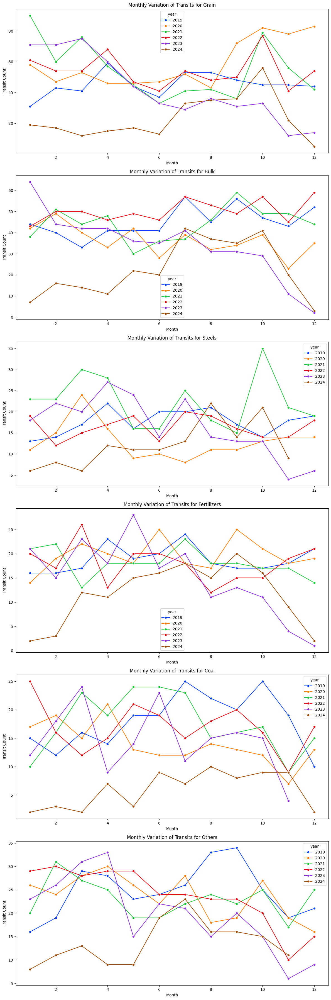

In [ ]:
# Define commodity groups
commodity_groups = ['Grain', 'Bulk', 'Steels', 'Fertilizers', 'Coal', 'Others']

# Create a figure and axes for the subplots
fig, axes = plt.subplots(nrows=len(commodity_groups), ncols=1, figsize=(12, 6 * len(commodity_groups)))

# Iterate through commodity groups
for i, commodity_group in enumerate(commodity_groups):
    # Filter data for the current commodity group
    filtered_data = Bulk_PA[Bulk_PA['commodity_group_top5'] == commodity_group]

    # Group data by year and month and count transits
    # Rename the 'proxy_transit_month' column in the groupby to avoid conflict
    monthly_data = filtered_data.groupby([filtered_data['proxy_transit_month'].dt.year.rename('year'), filtered_data['proxy_transit_month'].dt.month.rename('month')])['proxy_transit_month'].count().reset_index(name='transit_count')

    # Recreate the 'proxy_transit_month' column from 'year' and 'month'
    monthly_data['proxy_transit_month'] = pd.to_datetime(monthly_data['year'].astype(str) + '-' + monthly_data['month'].astype(str), format='%Y-%m')

    # Create the monthly chart using seaborn
    sns.lineplot(x='month', y='transit_count', hue='year', data=monthly_data, ax=axes[i], marker='o', palette="bright")

    # Set title and labels
    axes[i].set_title(f'Monthly Variation of Transits for {commodity_group}')
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Transit Count')

# Adjust layout and display the charts
plt.tight_layout()
plt.show()

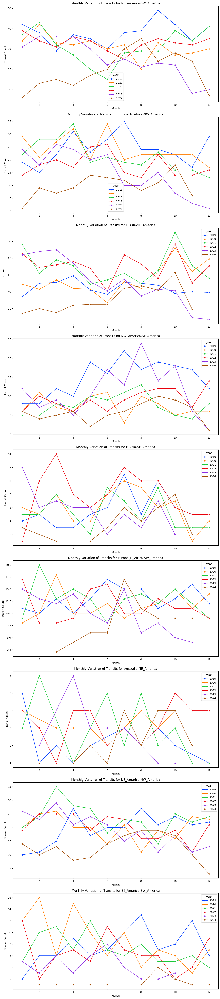

In [ ]:
# Define region pairs (replace with your actual region pairs)
region_pairs = Bulk_PA['region_pairs'].unique()

# Create a figure and axes for the subplots
fig, axes = plt.subplots(nrows=len(region_pairs), ncols=1, figsize=(12, 6 * len(region_pairs)))

# Iterate through region pairs
for i, region_pair in enumerate(region_pairs):
    # Filter data for the current region pair
    filtered_data = Bulk_PA[Bulk_PA['region_pairs'] == region_pair]

    # Group data by year and month and count transits
    monthly_data = filtered_data.groupby([filtered_data['proxy_transit_month'].dt.year.rename('year'), filtered_data['proxy_transit_month'].dt.month.rename('month')])['proxy_transit_month'].count().reset_index(name='transit_count')

    # Recreate the 'proxy_transit_month' column from 'year' and 'month'
    monthly_data['proxy_transit_month'] = pd.to_datetime(monthly_data['year'].astype(str) + '-' + monthly_data['month'].astype(str), format='%Y-%m')

    # Create the monthly chart using seaborn
    sns.lineplot(x='month', y='transit_count', hue='year', data=monthly_data, ax=axes[i], marker='o', palette="bright")

    # Set title and labels
    axes[i].set_title(f'Monthly Variation of Transits for {region_pair}')
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Transit Count')

plt.tight_layout()
plt.show()

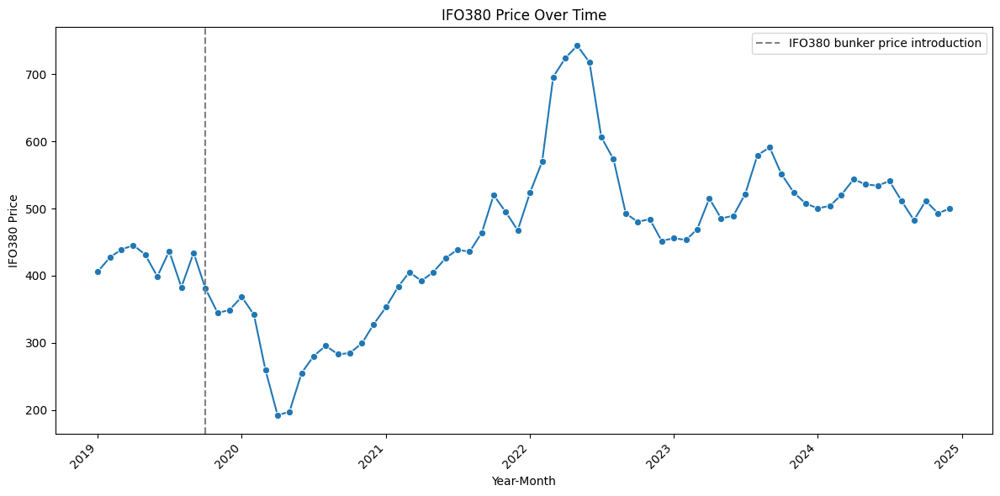

In [ ]:
# Assuming IFO380_19_24 is a DataFrame with 'Year_Month' and 'IFO380' columns
plt.figure(figsize=(12, 6))

# Convert 'Year_Month' to datetime before plotting
IFO380_19_24['Year_Month'] = IFO380_19_24['Year_Month'].dt.to_timestamp()

sns.lineplot(x='Year_Month', y='IFO380', data=IFO380_19_24, marker='o')

# Add vertical line for September 2019
plt.axvline(pd.to_datetime('2019-10-01'), color='grey', linestyle='--', label='IFO380 bunker price introduction')


plt.title('IFO380 Price Over Time')
plt.xlabel('Year-Month')
plt.ylabel('IFO380 Price')
plt.xticks(rotation=45, ha='right')
plt.legend()
plt.tight_layout()
plt.show()

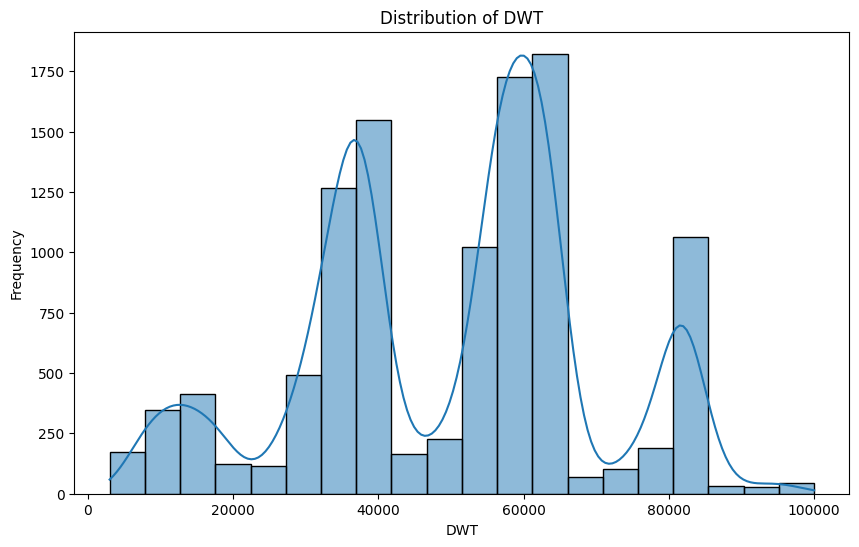

In [ ]:
# Assuming Bulk_PA is your DataFrame
plt.figure(figsize=(10, 6))
sns.histplot(Bulk_PA['vsl_dwt'][Bulk_PA['vsl_dwt']<= 100000], bins=20, kde=True)
plt.title('Distribution of DWT')
plt.xlabel('DWT')
plt.ylabel('Frequency')
plt.show()

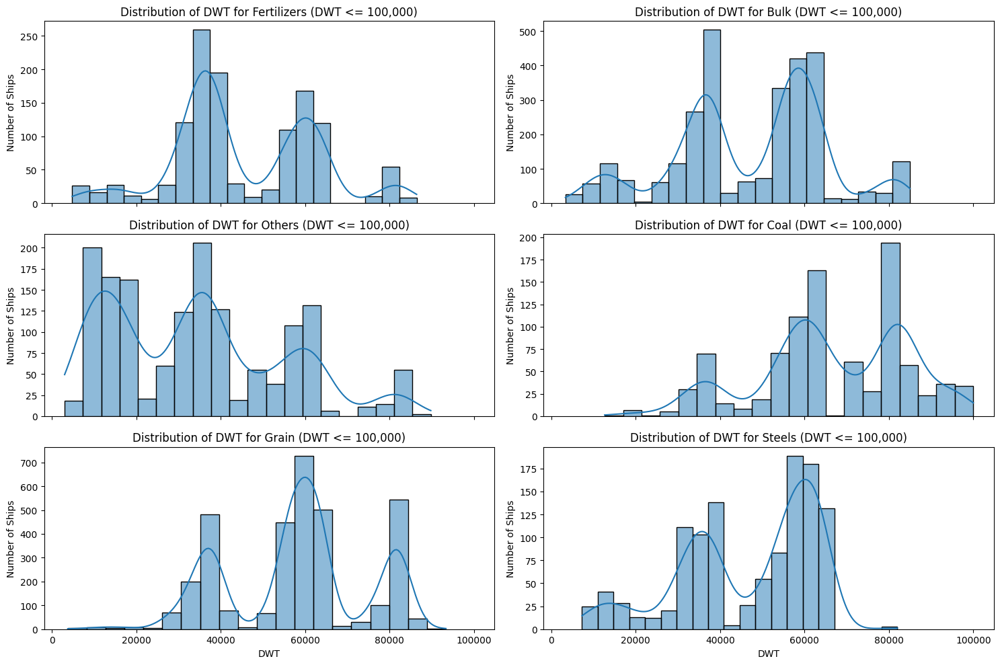

In [ ]:
# Assuming Bulk_PA is your DataFrame
commodity_groups = Bulk_PA['commodity_group_top5'].unique()

# Set up subplots in a 3x2 grid
num_cols = 2
num_rows = int(np.ceil(len(commodity_groups) / num_cols))
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(15, 10), sharex=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Loop through each commodity group and create histogram
for i, group in enumerate(commodity_groups):
    # Filter data for DWT less than 100,000
    filtered_data = Bulk_PA[(Bulk_PA['commodity_group_top5'] == group) & (Bulk_PA['vsl_dwt'] <= 100000)]

    ax = sns.histplot(filtered_data['vsl_dwt'],
                      bins=20, kde=True, stat="count", ax=axes[i])

    axes[i].set_title(f'Distribution of DWT for {group} (DWT <= 100,000)')
    axes[i].set_xlabel('DWT')
    axes[i].set_ylabel('Number of Ships')

# Hide any unused subplots
for j in range(len(commodity_groups), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# Distribution of the number of transits per commodity
# List commodities and their groups, then display the top 10
#filter Bulk Pa before june 2023
Bulk_PA_before_june = Bulk_PA[Bulk_PA['proxy_transit_month'] < pd.Period('2023-06', freq='M')]
commodity_group_counts = Bulk_PA_before_june.groupby(['commodity_group', 'commodity'])['commodity'].count().reset_index(name='count')

# Sort by count in descending order, take the top 10, and reset the index
top_10_commodities = commodity_group_counts.sort_values('count', ascending=False).head(20).reset_index(drop=True)

# Calculate total commodity count in Bulk_PA
total_commodity_count = Bulk_PA_before_june['commodity'].count()

# Add a percentage column
top_10_commodities['percentage'] = (top_10_commodities['count'] / total_commodity_count * 100).map('{:.2f}%'.format)

# Calculate cumulative percentage
top_10_commodities['cumulative_percentage'] = top_10_commodities['count'].cumsum() / total_commodity_count * 100
top_10_commodities['cumulative_percentage'] = top_10_commodities['cumulative_percentage'].map('{:.2f}%'.format)


# Display the top 10 with percentage and cumulative percentage
display(top_10_commodities)

,commodity_group,commodity,count,percentage,cumulative_percentage
0,Grain,Corn,1385,15.28%,15.28%
1,Grain,Soybeans,821,9.06%,24.34%
2,Coal,Steam Coal,647,7.14%,31.48%
3,Bulk,Salt,572,6.31%,37.79%
4,Steels,Steels,514,5.67%,43.46%
5,Bulk,Petroleum Coke,514,5.67%,49.13%
6,Bulk,Copper Concentrate,381,4.20%,53.34%
7,Grain,Wheat,349,3.85%,57.19%
8,Fertilizers,Phosphate Rock,260,2.87%,60.06%
9,Agriprods,Sugar,215,2.37%,62.43%


In [ ]:
# Distribution of the number of transits per commodity
# List commodities and their groups, then display the top 10
#filter Bulk Pa before june 2023
Bulk_PA_after_june = Bulk_PA[Bulk_PA['proxy_transit_month'] >= pd.Period('2023-06', freq='M')]
commodity_group_counts = Bulk_PA_after_june.groupby(['commodity_group', 'commodity'])['commodity'].count().reset_index(name='count')

# Sort by count in descending order, take the top 10, and reset the index
top_10_commodities = commodity_group_counts.sort_values('count', ascending=False).head(20).reset_index(drop=True)

# Calculate total commodity count in Bulk_PA
total_commodity_count = Bulk_PA_after_june['commodity'].count()

# Add a percentage column
top_10_commodities['percentage'] = (top_10_commodities['count'] / total_commodity_count * 100).map('{:.2f}%'.format)

# Calculate cumulative percentage
top_10_commodities['cumulative_percentage'] = top_10_commodities['count'].cumsum() / total_commodity_count * 100
top_10_commodities['cumulative_percentage'] = top_10_commodities['cumulative_percentage'].map('{:.2f}%'.format)


# Display the top 10 with percentage and cumulative percentage
display(top_10_commodities)

,commodity_group,commodity,count,percentage,cumulative_percentage
0,Grain,Corn,258,14.97%,14.97%
1,Steels,Steels,161,9.34%,24.30%
2,Coal,Steam Coal,117,6.79%,31.09%
3,Grain,Soybeans,89,5.16%,36.25%
4,Bulk,Salt,88,5.10%,41.36%
5,Bulk,Petroleum Coke,87,5.05%,46.40%
6,Grain,Wheat,80,4.64%,51.04%
7,Fertilizers,Phosphate Rock,79,4.58%,55.63%
8,Bulk,Copper Concentrate,64,3.71%,59.34%
9,Bulk,Slag,41,2.38%,61.72%
